## ИССЛЕДОВАНИЕ РЫНКА ОБЩЕСТВЕННОГО ПИТАНИЯ МОСКВЫ 


### Цель и задачи исследований
  Задачей исследования является выявление основных закономерностей в предоставленных данных, связанных с различными переменными
факторами работы заведений общественного питания Москвы: категории заведений, режим их работы и сетевая принадлежность, рейтинги 
заведений различных категорий и оценка их среднего чека, условия работы заведений (число посадочных мест, район локализации, 
ценовой уровень и пр.). Целью исследования является выявление оптимальных условий учреждения новой кофейни и выдача рекомендаций
по району расположения кофейни, ее ожидаемых ценовой и сетевой категорий, наилучшем режиме работы и прогнозируемому рейтингу.

### ЭТАПЫ ВЫПОЛНЕНИЯ РАБОТЫ
1. [Открытие данных и подготовка данных для анализа](#start)
2. [Предобработка данных](#cond)
3. [Анализ данных](#analys)  
4. [Распределение заведений по категориям](#spread)
5. [Изучение распределения посадочных мест](#seat)
6. [Сравнение количества сетевых и несетевых заведений](#set)
7. [Распределение заведений по роайонам Москвы](#region)
8. [Сравнение рейтингов различных категорий заведений](#rank)
9. [Построение рейтинговой карты Москвы и размещение на ней маркеров заведений](#card)
10. [Распределение заведений по самым загруженным улицам](#street)
11. [Анализ величины медианного чека в разных районах Москвы](#check)
12. [Влияние рейтинга заведений и режима их работы на величину медианного чека](#number)
13. [Изучение влияния рейтинга заведений на величину среднего чека](#mean)
14. [Выводы](#conc)
15. [Детализация плана по учреждению кофейни](#plan)
16. [Оптимальное расположение кофейни](#loc)
17. [Ссылка на презентацию](#vis)

Источник данных размещен на яндекс-диске:
    moscow_places.csv (https://disk.yandex.ru/d/qFIW2V9wAfOnbQ) 

<div class="alert alert-info">
  <b> ПОДГОТОВКА ДАННЫХ ДЛЯ АНАЛИЗА </b>
    <a id="start"></a> 
</div>

In [99]:
import pandas as pd
import requests
from urllib.parse import urlencode
base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?' 
public_key = 'https://disk.yandex.ru/d/qFIW2V9wAfOnbQ' 
final_url = base_url + urlencode(dict(public_key=public_key)) 
response = requests.get(final_url) 
download_url = response.json()['href'] 
download_response = requests.get(download_url) 
df = pd.read_csv(download_url)
df[:5]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


<div class="alert alert-info">
  Таблица содержит 14 столбцов и 8406 строк. Изучение типов данных в столбцах показывает, что все все данные имеют верный тип, кроме столбца 'seats', который должен 
иметь тип "integer".

</div>

In [46]:
df['seats'] = df['seats'].fillna(0)
df['seats'] = df['seats'].astype('int64', errors = 'ignore') 

In [47]:
df['seats'].dtype


dtype('int64')

<div class="alert alert-info">
  Тип данных в столбце 'seats' перевели в "integer".
<a id="some_id"></a> 
</div>

In [48]:
df.duplicated().sum()

0

<div class="alert alert-info">
  Явных дубликатов в данных не обнаружено

</div>

In [12]:
d = ['category','address','district','hours','price','avg_bill']
for i in d:
    df[i] = df[i].str.lower()

In [49]:
df.duplicated().sum()

0

<div class="alert alert-info">
  Перевод всех данных столбцов с типом 'object' в строчный режим не выявил неявных дубликатов

</div>

In [50]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                   0
dtype: int64

In [51]:
df['price'].unique()

array([nan, 'выше среднего', 'средние', 'высокие', 'низкие'], dtype=object)

<div class="alert alert-info">
  Cтолбец 'avg_bill' имеет 4590 пропусков, которые заполнить нельзя, так это приведет к искажению информации. Число пропусков
в столбце 'price' с категориальной оценкой чека (5091) меньше, чем в столбцах 'middle_avg_bill'(5257) и 'middle_coffee_cup'(7871) 
с численной оценкой чека, что позволяет заменить в них часть пропусков на медианные значения, характерные для категорий в
столбце 'price'.

</div>

In [52]:
d = ['выше среднего','средние','высокие','низкие']
for i in d:
    df.loc[(df['price']==i) & (df['middle_avg_bill'].isna()),'middle_avg_bill'] =  df.loc[df['price']==i, 'middle_avg_bill'].median()

In [53]:
d = ['выше среднего','средние','высокие','низкие']
for i in d:
    df.loc[(df['price']==i) & (df['middle_coffee_cup'].isna()),'middle_coffee_cup'] =  df.loc[df['price']==i, 'middle_coffee_cup'].median()

In [54]:
df.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      4621
middle_coffee_cup    4834
chain                   0
seats                   0
dtype: int64

<div class="alert alert-info">
  Проведенные замены на медианные значения позволили снизить количество пропусков в столбцах 'middle_avg_bill' и 'middle_coffee_cup'
до 4621 и 4834, соответственно, что позволило расширить выборку данных для дальнейшего анализа.     

</div>

<div class="alert alert-info">
  <b> ПРЕДОБРАБОТКА ДАННЫХ </b>   
 <a id="cond"></a> 
</div>

In [55]:
def street(w):
    s = str(w)
    r = s.split(',')
    return r[1]
df['street'] = df['address'].apply(street)

<div class="alert alert-info">
  Создан столбец 'street' с названием улиц.
</div>

In [56]:
def reg(w):
    s = str(w)
    if ('ежедневно' in s) and ('круглосуточно' in s):
        return True
    else:
        return False
df['is_24/7'] = df['hours'].apply(reg)

<div class="alert alert-info">
  Добавлен столбец 'is_24/7' c булевыми значениями
</div>

<div class="alert alert-info">
  <b> АНАЛИЗ ДАННЫХ </b>   
<a id="analys"></a> 
</div>

<div class="alert alert-info">
  РАСПРЕДЕЛЕНИЕ ЗАВЕДЕННИЙ ПО КАТЕГОРИЯМ 
<a id="spread"></a> 
</div>

In [20]:
import matplotlib.pyplot as plt

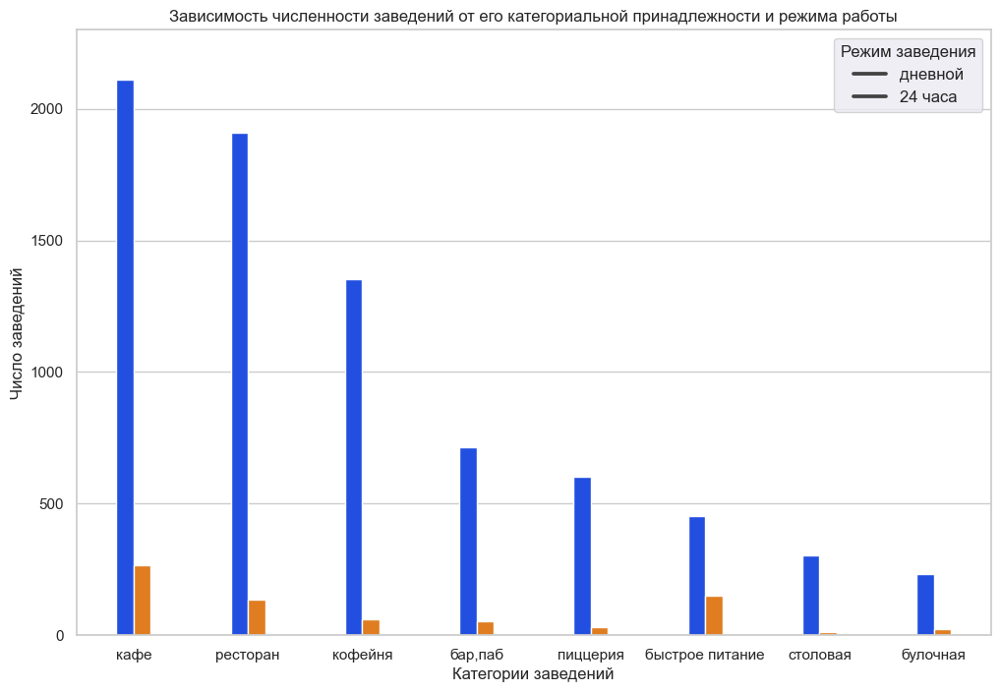

In [57]:
import seaborn as sns
sns.set_style('whitegrid')
sns.set_palette('bright')
df_c = df.groupby(['category','is_24/7'], as_index = False)['name'].count().sort_values(by = 'name', ascending = False)
ax = sns.barplot(x='category', y='name', data = df_c, width = 0.3, hue = 'is_24/7')
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории заведений',
        ylabel='Число заведений',
        ylim = (0,2300),
        title='Зависимость численности заведений от его категориальной принадлежности и режима работы')  
plt.legend(loc = 'upper right', title = 'Режим заведения', fontsize = 12, labels = ['дневной', '24 часа'])
plt.show()


<div class="alert alert-info">
  Доминируют кафе и рестораны. Кофеен примерно в 2 раза меньше, чем кафе. Меньше всего булочных и столовых - в 10 раз 
меньше, чем ресторанов. Предприятий быстрого питания, пиццерий и баров в 4 раза меньше, чем ресторанов, но в 2 раза больше, чем 
булочных и столовых. В каждой категории существуют круглосуточные заведения, но их численность ничтожна. Больше всего 
круглосуточных ресторанов, кафе и фастфудов (около 5 % от всех заведений каждого типа). Доля круглосуточных кофеен, баров и
пиццерий менее 5 % от их общего числа. Практически отсутствуют круглосуточные столовые и булочные.
</div>

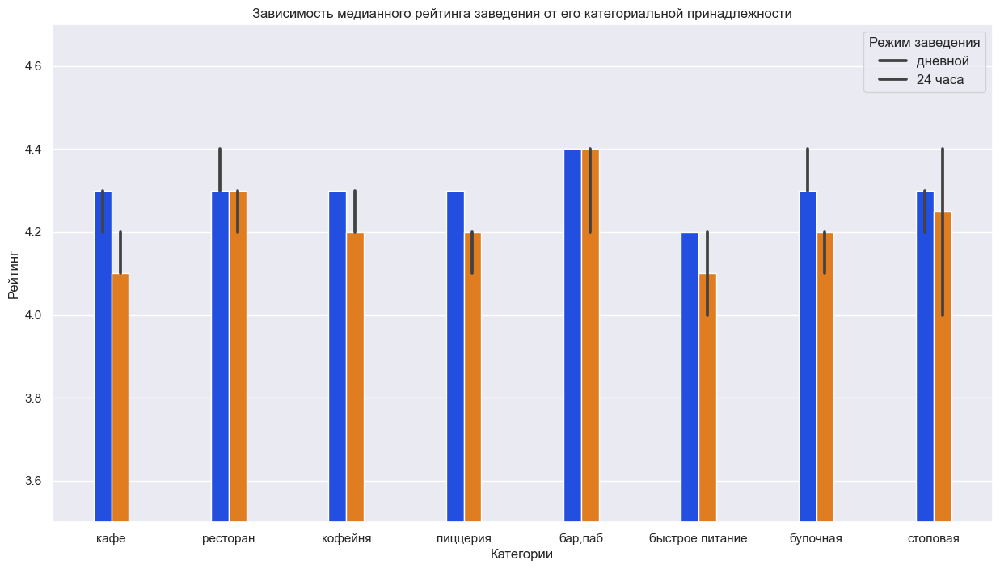

In [58]:
import seaborn as sns
sns.set_style('darkgrid')
sns.set_palette('bright')
ax = sns.barplot(x='category', y='rating', data = df, estimator = 'median', width = 0.3, hue = 'is_24/7')
sns.set(rc={'figure.figsize':(15,4)})
ax.set (xlabel='Категории',
        ylabel='Рейтинг',
        ylim = (3.5,4.7),
        title='Зависимость медианного рейтинга заведения от его категориальной принадлежности')  
plt.legend(loc = 'upper right', title = 'Режим заведения', fontsize = 12, labels = ['дневной', '24 часа'])
plt.show()


<div class="alert alert-info">
  Сравнение медианных рейтингов заведений показывавет, что самым высокой оценкой обладают бары и пабы (4,4). Кофейни, ресторны, 
кафе, пиццерии, булочные и столовые имеют близкий рейтинг порядка 4,3. Заведения фастфуда имеют самый низкий медианный рейтинг 
порядка 4,2. Можно также отметить, что переходл на 24 часовой режим работы, как правило понижает (на 0,1 - 0,2) медианный рейтинг для заведений
заведений большинства категорий. Нечуствительны к режиму работы только рестораны и пабы. 
</div>

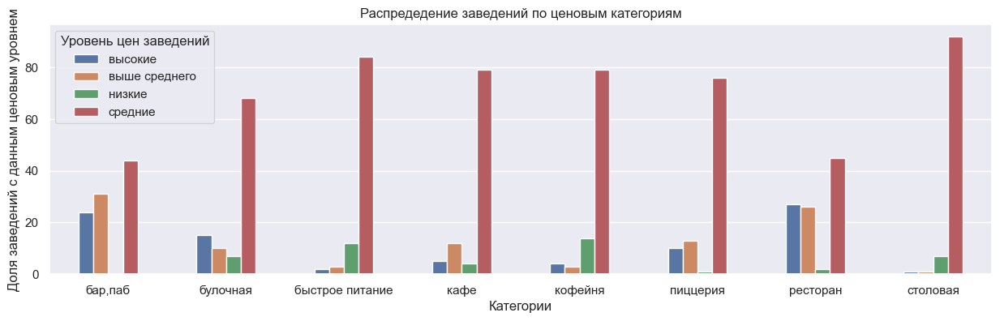

In [59]:
sns.set_style('darkgrid')
df_c = df.groupby(['category','price'], as_index = False)['name'].count()
df_c['sum'] = df_c['name']
d = ['бар,паб','булочная','быстрое питание','кафе','кофейня','пиццерия','ресторан', 'столовая']
for i in d:
    df_c.loc[df_c['category']==i, 'sum'] = df_c.loc[df_c['category']==i, 'name'].sum() 
df_c['ratio'] = round(df_c['name']*100/df_c['sum'])

ax = sns.barplot(x = 'category', y = 'ratio', data = df_c, width = 0.5, hue = 'price')
sns.set(rc={'figure.figsize':(15,6)})
ax.set (xlabel='Категории',
        ylabel='Доля заведений c данным ценовым уровнем',
        title='Распредедение заведений по ценовым категориям')
plt.legend(loc = 'upper left', title = 'Уровень цен заведений')
plt.show()

<div class="alert alert-info">
  Для всех рассматриваемых категорий заведений характерно абсолютное преобладание средней ценовой категории. Доля заведений
со средними ценами для большинства категорий на порядок превосходит все остальные ценовые уровни. Исключение составляют только 
бары(пабы) и рестораны, для которых преобладание заведений со средними ценами не является существенным: общее число ресторанов 
и пабов с ценами выше среднего и высокого уровня превышает число ресторанов с ценами среднего уровня. 
</div>

In [60]:
!pip install plotly

In [61]:
df_c = df.pivot_table(index = 'category',values = ['middle_avg_bill','middle_coffee_cup'],aggfunc = 'median').sort_values(by = 'middle_avg_bill')


In [26]:
import plotly.express as px
fig = px.bar(df_c, y = ['middle_avg_bill','middle_coffee_cup'], height = 500, text_auto='.2s')
fig.update_layout(xaxis_title = 'Категории заведений', yaxis_title = 'Медианная цена, руб.', 
                  title = 'Зависимость медианных чека и кофе от типа заведения')
fig.update_traces(textfont_size=12, textangle=10, textposition="inside", cliponaxis=False)
fig.show()

<div class="alert alert-info">
  Наибольший медианный чек, как и следовало ожидать, в ресторанах и пабах, причем они практически равны по этому показателю. 
Булочные, кафе, кофейни и пиццерии имеют близкий медианный чек порядка 500 руб., что почти в 3 раза ниже, по сравнению с 
ресторанами и барами. Самые низкие цены в столовых - чек 300 руб. Самая высокая медианная стоимость чашки кофе (200 руб.) 
в барах, затем идут кофейни (170 руб.), кафе и пиццерии (по 150 руб.), и фасфуды (140 руб.).
</div>

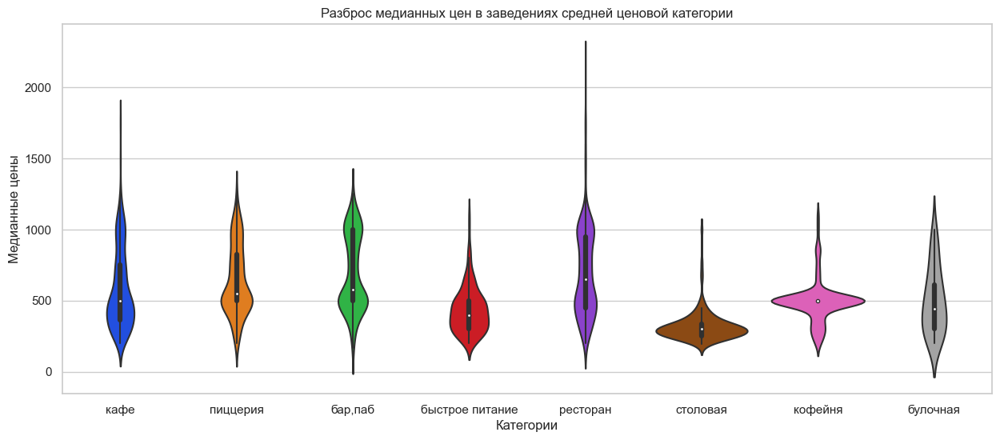

In [62]:
df_m = df.query('price == "средние"')
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.violinplot(x = 'category', y = 'middle_avg_bill', data = df_m, legend = False)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории',
        ylabel='Медианные цены',
        title='Разброс медианных цен в заведениях средней ценовой категории')
plt.show()

<div class="alert alert-info">
  Было проанализировано распределение величины среднего чека для заведений средней ценовой категории. По этому показателю 
заведения можно разделить на 2 категории. Заведения первой группы имеют выраженное 8-образное распределение плотности точек (кафе, пиццерии, 
бары и рестораны), что говорит о наибольшем разнообразии состоятельности клиентов, которые предпочитают либо более дорогие, либо дешевое 
заведения. Средний ценовой сегмент для этой группы представлен хуже. Заведения 2 группы (фастфуд, столовые, кофейни, булочные) 
имеют наибольшую плотность точек вблизи среднего чека, что говорит об их ориентации на более узкий диапазон клиентов со
средними достатком и максимальной сбалансированности предложения (блюд и продуктов) для посетителей со средними доходами. 
Вместе с тем, максимальное количество выбросов в сторону относительно дорогого чека, наряду с ресторанами, имеют также кафе,
фастфуды, столовые и кофейни, что говорит о присутствии на рынке нетипичных и довольно дорогих заведений данных категорий.
Булочные и пиццерии практически не имеют выбросов из-за целевой ориентации на мсугубо среднеценовую категорию клиентов и
отсутствия в меню каких-то нетипичных дорогих предложений.  
</div>

<div class="alert alert-info">
  <b> ИЗУЧЕНИЕ РАСПРЕДЕЛЕНИЯ ПОСАДОЧНЫХ МЕСТ </b>
  <a id="seat"></a>  
</div>

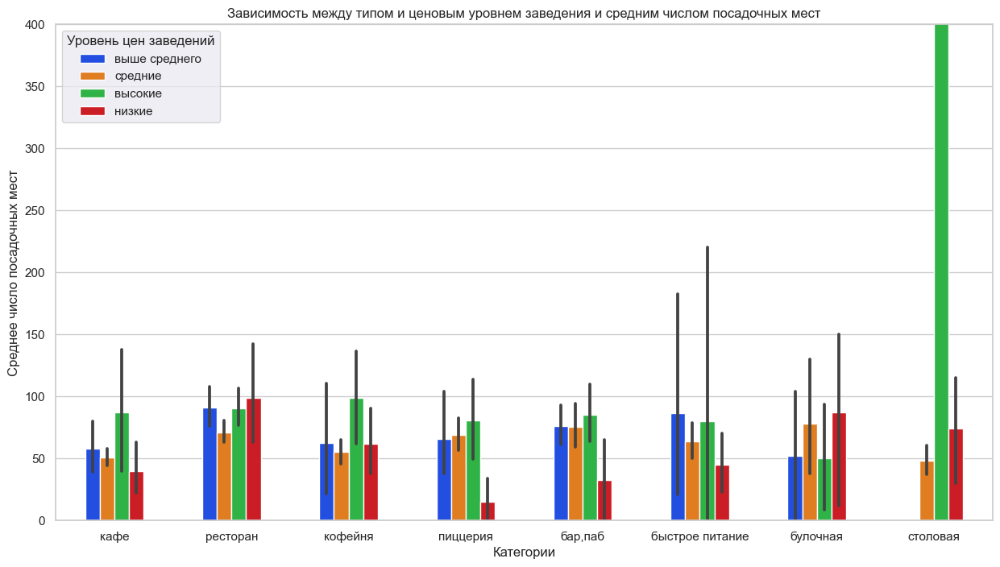

In [63]:
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'category', y = 'seats', data = df, estimator = 'mean', hue = 'price', width = 0.5)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории', ylim = (0,400),
        ylabel='Среднее число посадочных мест',
        title='Зависимость между типом и ценовым уровнем заведения и средним числом посадочных мест')
plt.legend(loc = 'upper left', title = 'Уровень цен заведений')
plt.show()


<div class="alert alert-info">
    Большинство заведений (рестораны, кофейни, кафе, фастфуды) имеют сбалансированное распределение средней величины 
посадочных мест по ценовым категориям с небольшим преобладанием высокого ценового сегмента. Для этих заведений число посадочных
мест в дорогих категориях на 20 - 30 % выше, чем в дешевых и средних категориях. В пиццериях и барах баланс посадочных мест
еще более смещен в сторону высоких ценоваых категорий - средние и дешевые заведения имеют в среднем на 70 % мешьше посадочных мест,
чем дорогие заведения. В булочных, наоборот, заведения дешевой и средней ценовых категорий имеют на 70 % больше посадочных мест,
чем более дорогие аналоги. Аномальное число посадочных мест в дорогих столовых является артефактом, которым можно пренебречь,
так как в выборке представлено только одно заведенние такого рода.
</div>

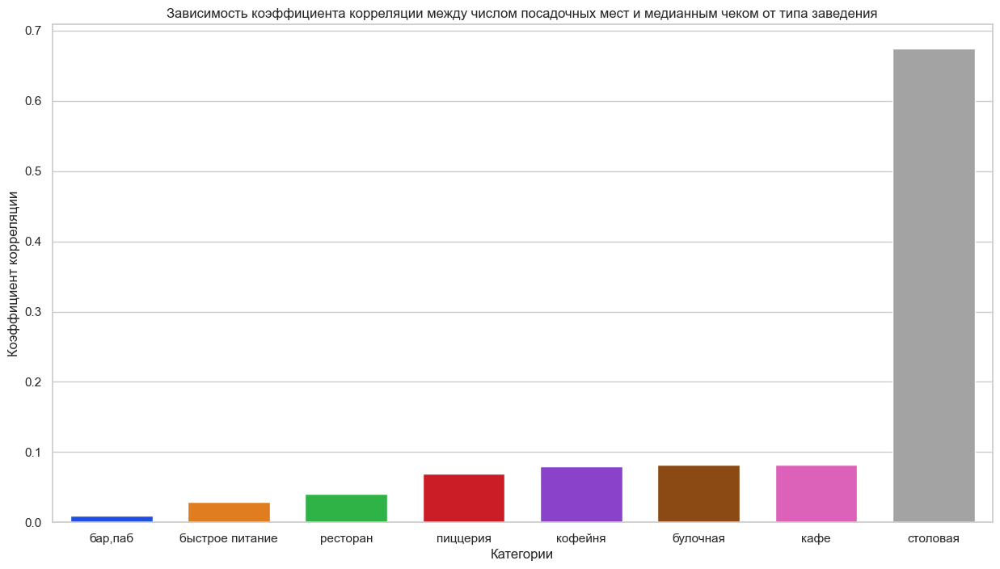

In [64]:

d  = list(df['category'].unique())
f = []
for i in d:
    df_g = df.loc[df['category']==i]
    f.append(df_g['seats'].corr(df_g['middle_avg_bill']))
b = sorted(enumerate(f), key=lambda i: i[1])
f.sort()
d1 = []
for i in range(len(b)):
    d1.append(d[b[i][0]])
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = d1, y = f, width = 0.7)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории',
        ylabel='Коэффициент корреляции',
        title='Зависимость коэффициента корреляции между числом посадочных мест и медианным чеком от типа заведения')
plt.show()

<div class="alert alert-info">
    В большинстве заведений не обнаружено значимой корреляции между числом посадочных мест и величиной среднего чека. Это говорит
о том, что размер заведения не связан с его престижем и общим уровнем ценовых предложений. Небольшая положительная корреляция
для пиццерий, кофеен и кафе связана скорее всего с возможностью принимать большие компании, когда сумма чека пропорциональна объему
заказа. При этом, крупные кгомпании и мероприятия не являются основополагающим фактором прибыли заведений. Из этого ряда
выбиваются столовые, для котороых средний чек четко коррелдирует с числом мест. Видимо, это свидетельствует о том, что чем 
крупнее столовая, тем более дорогие блюда у нее в ассортименте тем большее количенство больших компаний ее посещают и больше
проводится мероприятий. Однако, данная аномалия частично объясняется отсутствием столоваых дорогих сегментов, что непропорционально
увеличивает среднюю корреляцию.
</div>

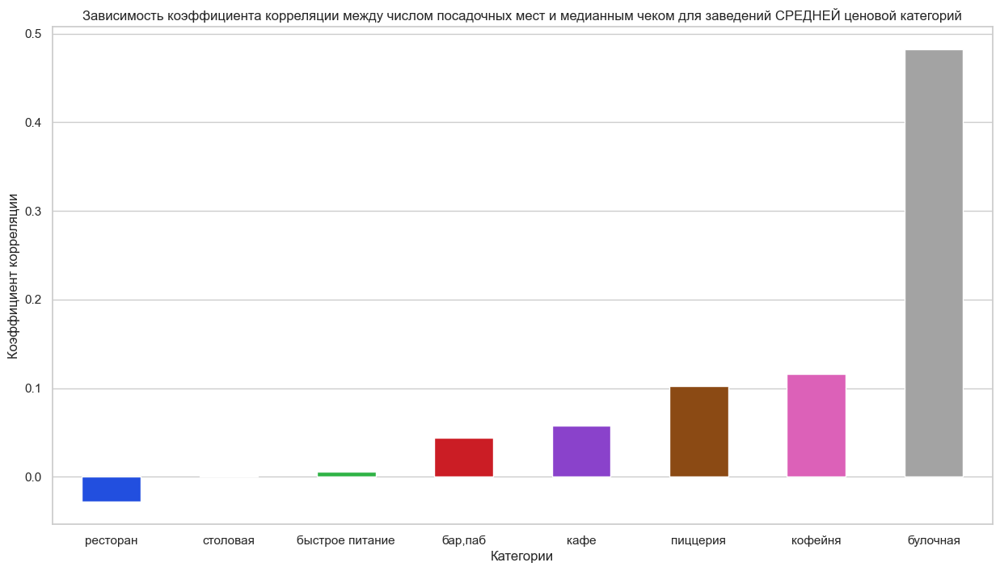

In [65]:
df_h = df.query('price == "средние"')
d  = list(df_h['category'].unique())
f = []
for i in d:
    df_g = df_h.loc[df_h['category']==i]
    f.append(df_g['seats'].corr(df_g['middle_avg_bill']))
b = sorted(enumerate(f), key=lambda i: i[1])
f.sort()
d1 = []
for i in range(len(b)):
    d1.append(d[b[i][0]])
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = d1, y = f, width = 0.5)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории',
        ylabel='Коэффициент корреляции',
        title='Зависимость коэффициента корреляции между числом посадочных мест и медианным чеком для заведений СРЕДНЕЙ ценовой категорий')
plt.show()

<div class="alert alert-info">
    В средней ценовой категории булочные имеют неплоxую корреляцию (0,45) между величиной среднего чека и средним количеством посадочных
мест. Кофейни, пиццерии, бары и особенно фастфуды демонстрируют практическую независимость чека от числа мест, а рестораны
имеют незначительную отрицательную корреляцию. Таким образом, для в средней ценовой категории для увеличения среднего чека 
целесообразно увеличить число мест только в булочных. В гораздо меньшей степени рост чисмла мест положительно сказывается на чеке
кафе, пиццерий, кофеен и баров.
</div>

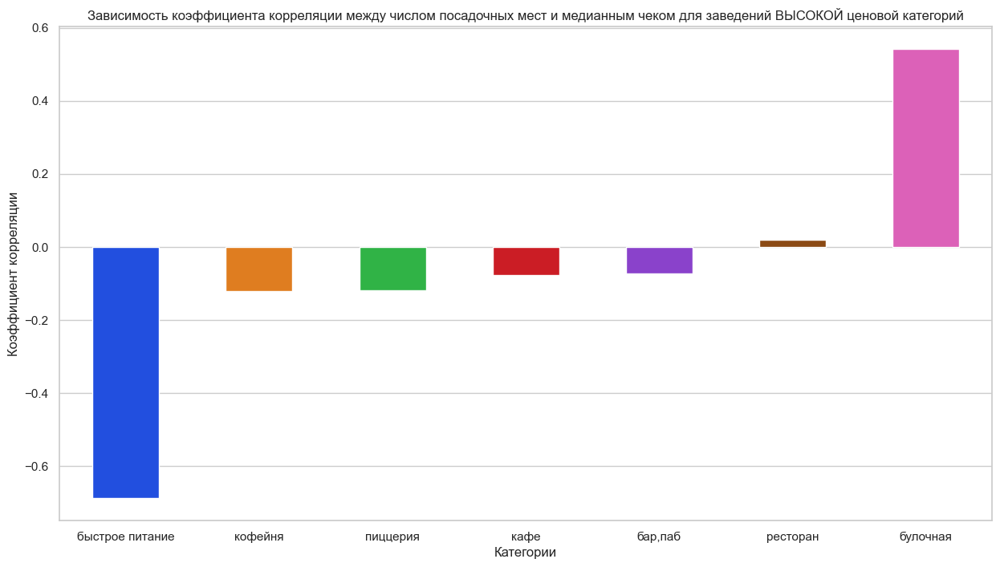

In [66]:
df_h = df.query('price == "высокие" and category != "столовая"')
d  = list(df_h['category'].unique())
f = []
for i in d:
    df_g = df_h.loc[df_h['category']==i]
    f.append(df_g['seats'].corr(df_g['middle_avg_bill']))
b = sorted(enumerate(f), key=lambda i: i[1])
f.sort()
d1 = []
for i in range(len(b)):
    d1.append(d[b[i][0]])
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = d1, y = f, width = 0.5)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории',
        ylabel='Коэффициент корреляции',
        title='Зависимость коэффициента корреляции между числом посадочных мест и медианным чеком для заведений ВЫСОКОЙ ценовой категорий')
plt.show()

<div class="alert alert-info">
    В высокой ценовой категории для увеличения среднего чека целесообразно увеличивать число посадочных мест только в булочных. 
Наоборот, увеличение числа мест в фастфудах отчетливо приводит к снижению среднего чека. Кофейни, пиццерии, кафе и бары весьма
слабо, но негативно реагируют на увеличение числа посадочных мест.
</div>

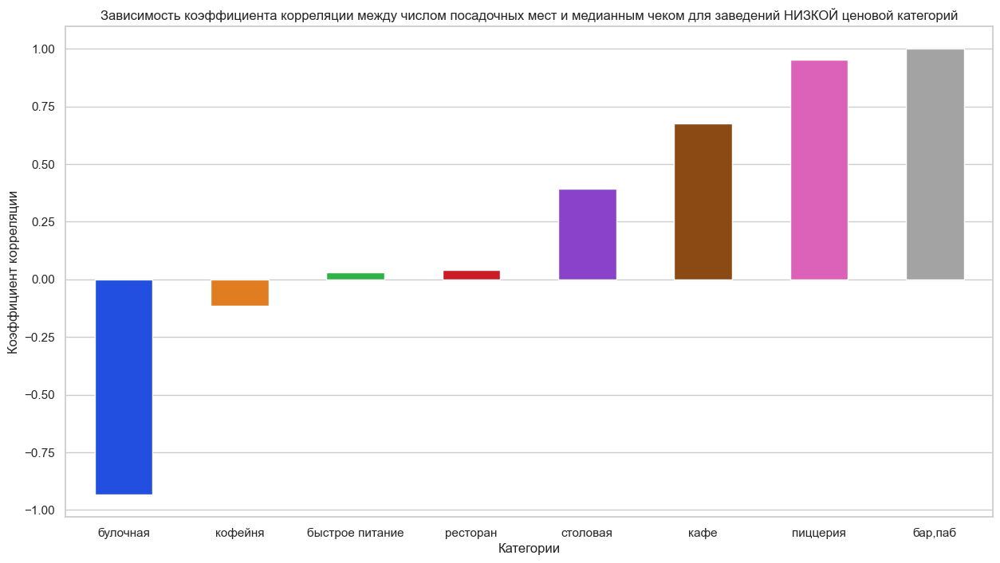

In [67]:
df_h = df.query('price == "низкие"')
d  = list(df_h['category'].unique())
f = []
for i in d:
    df_g = df_h.loc[df_h['category']==i]
    f.append(df_g['seats'].corr(df_g['middle_avg_bill']))
b = sorted(enumerate(f), key=lambda i: i[1])
f.sort()
d1 = []
for i in range(len(b)):
    d1.append(d[b[i][0]])
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = d1, y = f, width = 0.5)
sns.set(rc={'figure.figsize':(15,8)})
ax.set (xlabel='Категории',
        ylabel='Коэффициент корреляции',
        title='Зависимость коэффициента корреляции между числом посадочных мест и медианным чеком для заведений НИЗКОЙ ценовой категорий')
plt.show()

<div class="alert alert-info">
    В низкой ценовой категории увеличение посадочных мест в барах, пиццериях, кафе и столовых с высокой вероятностью увеличит
средний чек. Для булочных, наоборот, увеличение числа мест однозначно снижает средний чек.
</div>

<div class="alert alert-info">
  <b> СРАВНЕНИЕ КОЛИЧЕСТВА СЕТЕВЫХ И НЕСЕТЕВЫХ ЗАВЕДЕНИЙ </b>
   <a id="set"></a> 
</div>

In [68]:
df_m = df.groupby(['category','chain'], as_index = False).agg({'name':'count'}).sort_values(by = 'name')
fig = px.bar(df_m, x = 'category', y = 'name', text_auto='.2s', color = 'chain', height = 700)
fig.update_layout(xaxis_title = 'Категории заведений', yaxis_title = 'Число заведений', 
                  title = 'Влияние сетевой принадлежности на численность заведений различных типов', width = 1000)
fig.update_traces(textfont_size=12, textangle=0, textposition="inside", cliponaxis=False)
fig.show()


<div class="alert alert-info">
  Наибольшя доля сетевых заведений приходится на булочные (порядка 70 % сетевых булочных). Кофейни и пиццерии включают порядка 50 % 
сетевых заведений. Доля сетевых ресторанов, кафе и фастфудов порядка 30 - 40 %. Меньше всего доля сетевых столовых и баров - менее 30 %.
Таким образом, чаще всего приходится встречаться с сетеваыми булочными, кофейнями и пиццериями, а наименьшая вероятность встретить
сетевое заведение, посещая столовые и бары.

</div>

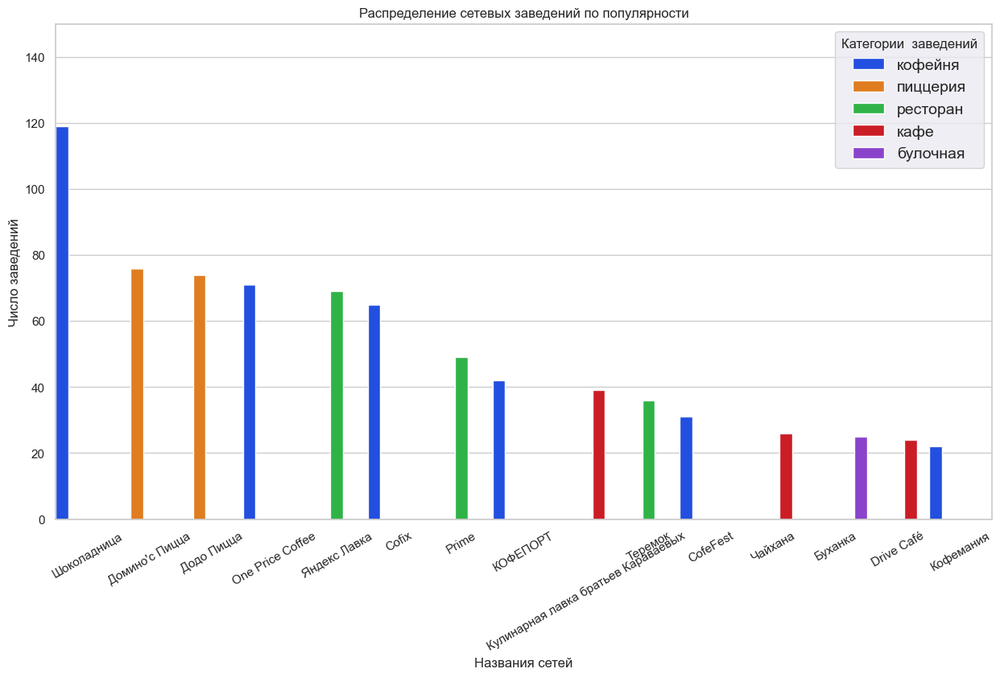

In [69]:
sns.set_style('whitegrid')
sns.set_palette('bright')
df_p = df.query('chain == 1')
df_p = df_p.groupby(['name','category'], as_index = False).agg({'chain':'count'}).sort_values(by = 'chain', 
                                                                                  ascending = False)[:15]
ax = sns.barplot(x = 'name', y = 'chain', data = df_p, hue = 'category', width = 1)
sns.set(rc={'figure.figsize':(12,8)})
ax.set (xlabel='Названия сетей', ylim = (0,150),
        ylabel='Число заведений',
        title='Распределение сетевых заведений по популярности')
plt.legend(loc = 'upper right', title = 'Категории  заведений', fontsize = 14)
plt.xticks(rotation = 30)
plt.show()

<div class="alert alert-info">
  Самая популярная сеть - Шоколадница (120 объектов), замыкает 15 популярнейших сетей Му-Му (менее 30 объектов). В топ-5 вошли 2 
пиццерии (Доминос и Додо), 2 кофейни (Шоколадница и One-Price-Coffee). Всего же в топ-15 входят 6 кофеен, 2 пиццерии, 3 ресторана,
3 кафе и 1 булочная.
</div>

<div class="alert alert-info">
  <b> РАСПРЕДЕЛЕНИЕ ЗАВЕДЕНИЙ ПО РАЙОНАМ МОСКВЫ </b>
    <a id="region"></a> 
</div>

In [70]:
len(df['district'].unique())

9

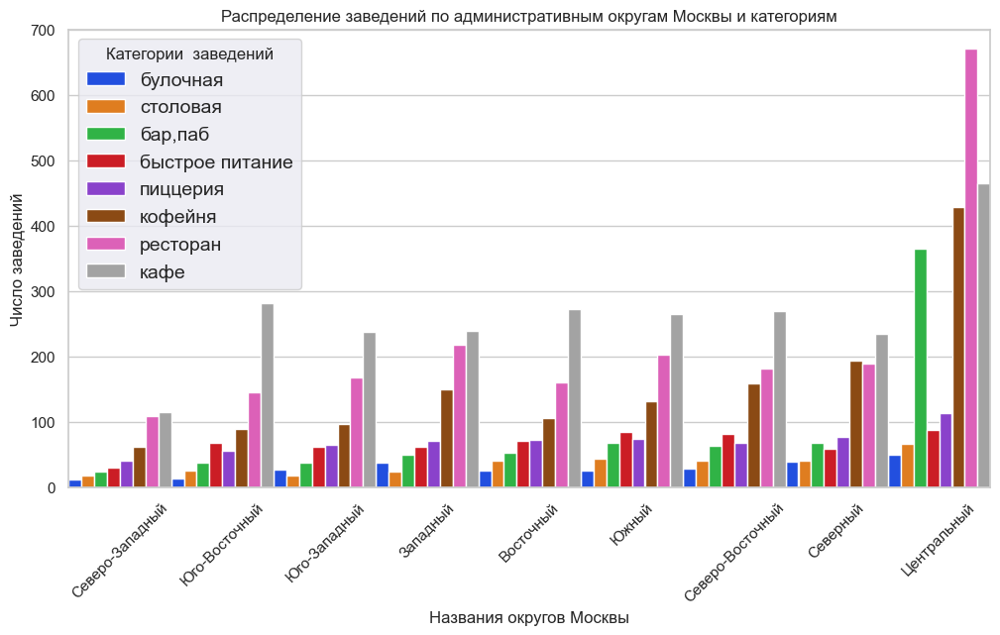

In [93]:
def f(g):
    d = str(g)
    return d.split(' ')[0]
df['district'] = df['district'].apply(f)
df_c = df.groupby(['district','category'], as_index = False).agg({'name':'count'}).sort_values(by = 'name')
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'district', y = 'name', data = df_c, hue = 'category', width = 1)
sns.set(rc={'figure.figsize':(12,8)})
ax.set (xlabel='Названия округов Москвы', ylim = (0,700),
        ylabel='Число заведений',
        title='Распределение заведений по административным округам Москвы и категориям')
plt.legend(loc = 'upper left', title = 'Категории  заведений', fontsize = 14)
plt.xticks(rotation = 45)
plt.show()

<div class="alert alert-info">
  Количество заведений в Центральном округе Москвы примерно в 2 раза превышает общее число заведений в каждом из прочих округов. 
Все остальные оуруга имеют примерно одинаковое общее число заведений, за исключением Северо-Западного округа, число заведений 
в котором примерно в 1,5 раза ниже. При анализе категорий заведений можно сказать, что во всех округах с серьезным отрывом 
преобладают кафе. В топ-6 категорий почти во всех округах входят (по убыванию численности): кафе, реастораны, кофейни, пиццерии,
фастфуды и бары. Исключение составляет Центральный округ, в котором аномально доминируют рестораны, а бары находятся на 4 месте,
опережая пиццерии и фастфуды. Можно также отметить, что в Северном округе рестораны и кофейни одинаково популярны. 
</div>

<div class="alert alert-info">
  <b> СРАВНЕНИЕ РЕЙТИНГОВ РАЗЛИЧНЫХ КАТЕГОРИЙ ЗАВЕДЕНИЙ </b>
   <a id="rank"></a>  
</div>

<Axes: title={'center': 'Сравнение среднего рейтинга заведений'}, xlabel='Категории заведений', ylabel='Средний рейтинг заведений'>

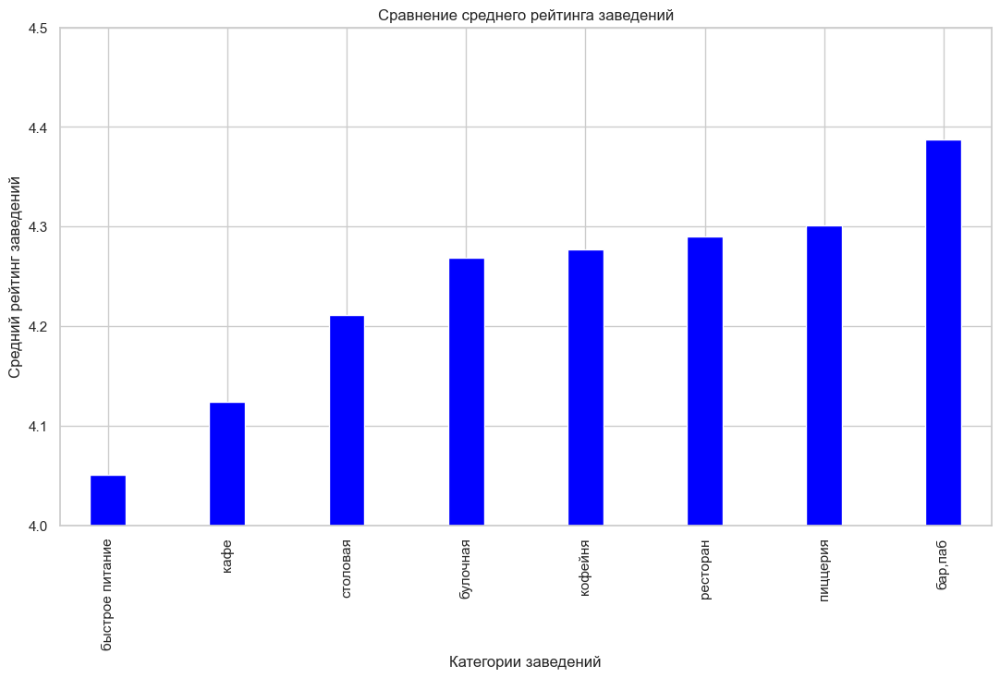

In [72]:
sns.set_style('whitegrid')
sns.set_palette('bright')
df.pivot_table(index = 'category',values = 'rating', aggfunc = 'mean').sort_values(by = 'rating').plot(kind = 'bar', 
                                                                                   figsize = (13,7), color = 'blue',
                                                                                   title = 'Сравнение среднего рейтинга заведений', 
                                                                                   width = 0.3, ylim = (4,4.5),
                                                                                   xlabel = 'Категории заведений',
                                                                                   ylabel = 'Средний рейтинг заведений', legend = False)


<div class="alert alert-info">
  Наиболее рейтинговыми заведениями являются бары, пиццерии и рестораны. Чуть менее популярны кофейни и булочные. Самым низким 
рейтингом обладают фастфуды и кафе.
</div>

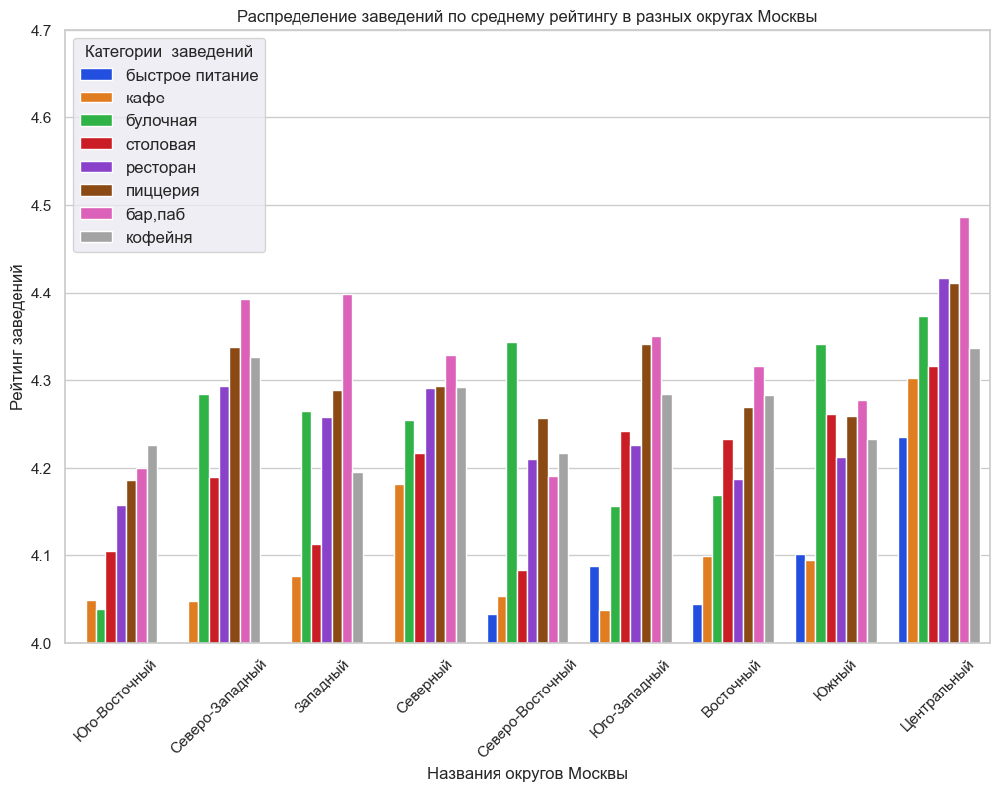

In [73]:
df_c = df.groupby(['district','category'], as_index = False).agg({'rating':'mean'}).sort_values(by = 'rating')
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'district', y = 'rating', data = df_c, width = 0.8, hue = 'category')
sns.set(rc={'figure.figsize':(12,8)})
ax.set (xlabel='Названия округов Москвы', ylim = (4,4.7),
        ylabel='Рейтинг заведений',
        title='Распределение заведений по среднему рейтингу в разных округах Москвы')
plt.legend(loc = 'upper left', title = 'Категории  заведений', fontsize = 12)
plt.xticks(rotation = 45)
plt.show()

<div class="alert alert-info">
В большинстве округов лидируют по рейтингу бары и пабы. Затем идут пиццерии, рестораны и кофейни. Выделяются Северо-Восточный и 
Южный округа, где лидируют булочные. Наиболее низкие рейтинги у кафе и фастфудов.  
</div>

<div class="alert alert-info">
  <b> ПОСТРОЕНИЕ РЕЙТИНГОВОЙ КАРТЫ МОСКВЫ И РАЗМЕЩЕНИЕ НА НЕЙ МАРКЕРОВ ЗАВЕДЕНИЙ </b>
    <a id="card"></a>
</div>

In [74]:
!pip install folium

In [75]:
import folium
from folium import Marker, Map
from folium.plugins import MarkerCluster
mos_lat, mos_lng = 55.75, 37.62
m = Map(location = [mos_lat, mos_lng], zoom_start = 10)
m_cluster = MarkerCluster().add_to(m)
df_m = df.groupby('district', as_index = False).agg({'rating':'mean'})
def g(row):
    Marker([row['lat'], row['lng']], tooltip = row['category'], popup = f"{row['name']} {row['rating']}").add_to(m_cluster)
df.apply(g, axis = 1)
path = 'C:\\Users\\79284\\Documents\\'
state_geo = path + 'admin_level_geomap — копия.geojson'
folium.Choropleth(
    geo_data = state_geo,
    data = df_m,
    columns = ['district', 'rating'],
    key_on = 'feature.name',
    fill_color = 'YlOrBr',
    fill_opacity = 0.1,
    legend_name = 'Рейтинговая карта',
    ).add_to(m)
m


<div class="alert alert-info">
  <b> РАСПРЕДЕЛЕНИЕ ЗАВЕДЕНИЙ ПО САМЫМ ЗАГРУЖЕННЫМ УЛИЦАМ </b>
     <a id="street"></a>
</div>

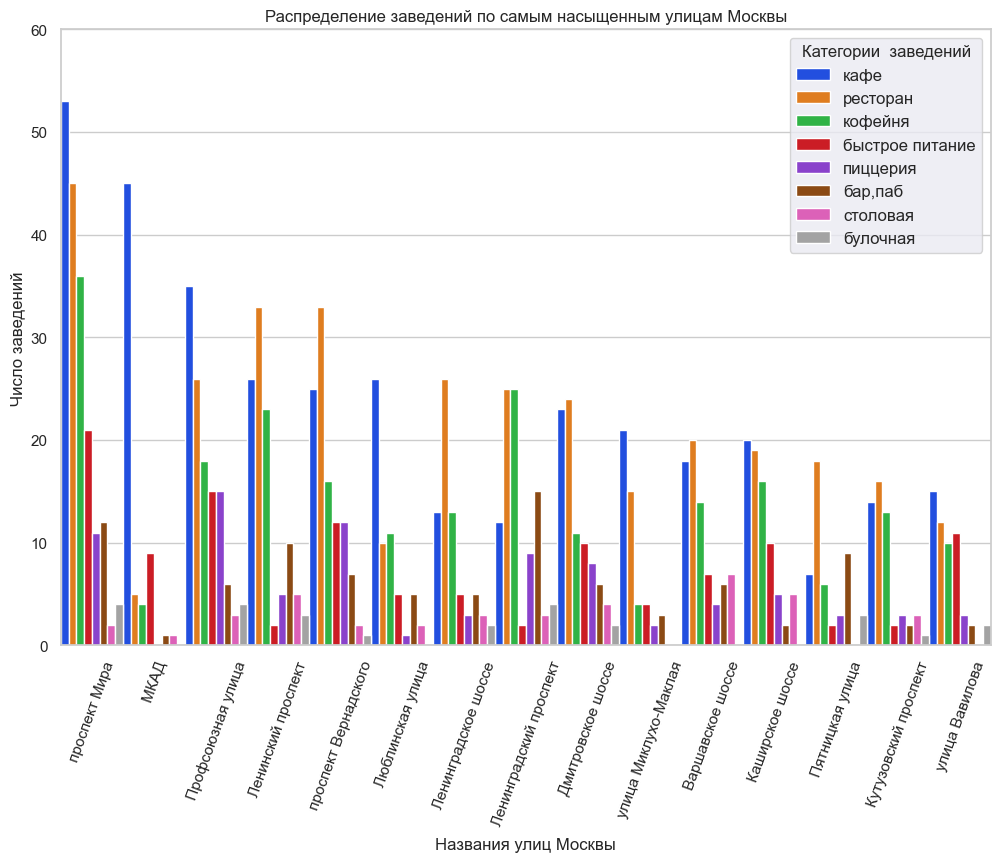

In [76]:
df_c = df.groupby('street', as_index = False).agg({'name':'count'}).sort_values(by = 'name', ascending = False)[:15]
f = list(df_c['street'])
df_f = df[df.street.isin(f)]
df_w = df_f.groupby(['street','category'], as_index = False).agg({'name':'count'}).sort_values(by = 'name', ascending = False)
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'street', y = 'name', hue = 'category', data = df_w, width = 1)
sns.set(rc={'figure.figsize':(12,8)})
ax.set (xlabel='Названия улиц Москвы', ylim = (0,60),
        ylabel='Число заведений',
        title='Распределение заведений по самым насыщенным улицам Москвы')
plt.legend(loc = 'upper right', title = 'Категории  заведений', fontsize = 12)
plt.xticks(rotation = 70)
plt.show()

<div class="alert alert-info">
  В топ-5 самых еасыщенных различными заведениями улиц входят проспект Мира, МКАД, Профсоюзная улица, Ленинский проспект и проспект
Вернадского. Распределение заведений по категриям, в целом, тождественно для разных улиц и напоминает распределение заведений
по округам Москвы: на первом месте кафе, затем идут рестораны и кофейни. Фастфуды, пиццерии и бары занимают следующие строчки,
с переменным преобладанием от улицы к улице. Аутсайдерами являются булочные и столовые. 
</div>

In [77]:
df_c = df.groupby('street', as_index = False).agg({'name':'count'})
len(df_c.query('name == 1'))

458

C:\Users\79284\AppData\Local\Temp\ipykernel_21252\1818968859.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



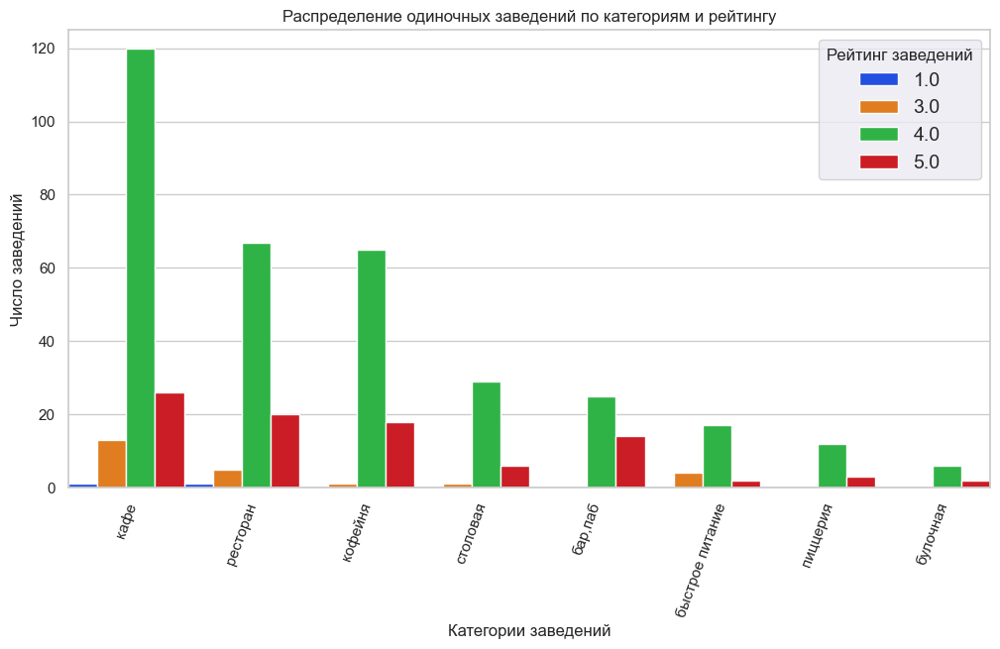

In [79]:

df_c = df_c.query('name == 1')
f = list(df_c['street'])
df_f = df[df.street.isin(f)]
df_f.rating = df_f.rating.round()
df_w = df_f.groupby(['category','rating'], as_index = False).agg({'name':'count'}).sort_values(by = 'name', ascending = False)
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'category', y = 'name', hue = 'rating', data = df_w, width = 1)
sns.set(rc={'figure.figsize':(12,6)})
ax.set (xlabel='Категории заведений', ylim = (0,125),
        ylabel='Число заведений',
        title='Распределение одиночных заведений по категориям и рейтингу')
plt.legend(loc = 'upper right', title = 'Рейтинг заведений', fontsize = 14)
plt.xticks(rotation = 70)
plt.show()

<div class="alert alert-info">
  Среди одиночных заведений преобладают кафе, рестораны и кофейни (аналогичо распределению заведений по округам и насыщенным 
улицам Москвы). Далее следуют столовые и бары, наименее распространены пиццерии и булочные. Среди всех категорий заведений с 
большим отрывом преобладают предприятия с хорошим рейтингом (4), затем идут точки с отличным рейтингом (5). Заведений с низким
рейтингом (3 и ниже) во всех катеориях незначительное количество до полного отсутствия (бары, пиццерии и булочные).  
</div>

<div class="alert alert-info">
  <b> АНАЛИЗ ВЕЛИЧИНЫ МЕДИАННОГО ЧЕКА В РАЗНЫХ РАЙОНАХ МОСКВЫ </b>
    <a id="check"></a>
</div>

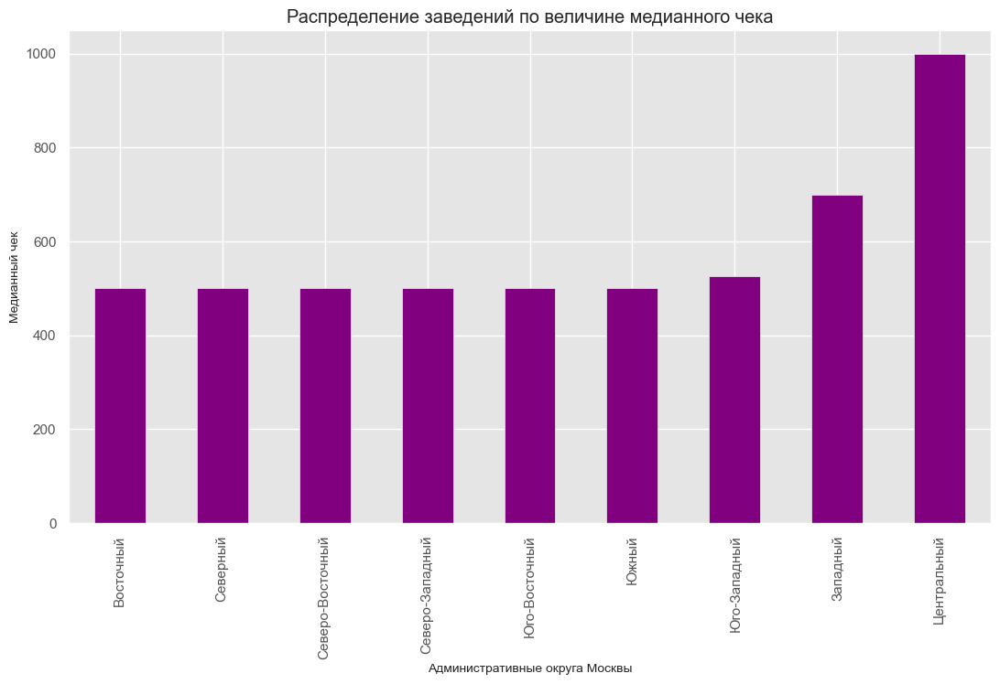

In [80]:
plt.style.use('ggplot')
df.groupby('district').agg({'middle_avg_bill':'median'}).sort_values(by = 'middle_avg_bill').plot(kind='bar', figsize = (13,7), color = 'purple',
                                                         title = 'Распределение заведений по величине медианного чека',
                                                         xlabel = 'Административные округа Москвы',
                                                         ylabel = 'Медианный чек', legend = False);

<div class="alert alert-info">
  Во всех округах Москвы величина медианного чека заведений (без дифференциации на категории) примерно одинакова (около 500 руб). 
Исключения составляют Юго-Западный, Западный и Центральный округа, где медианный чек растет, соответственно, до 550, 700 и 1000 руб.
</div>

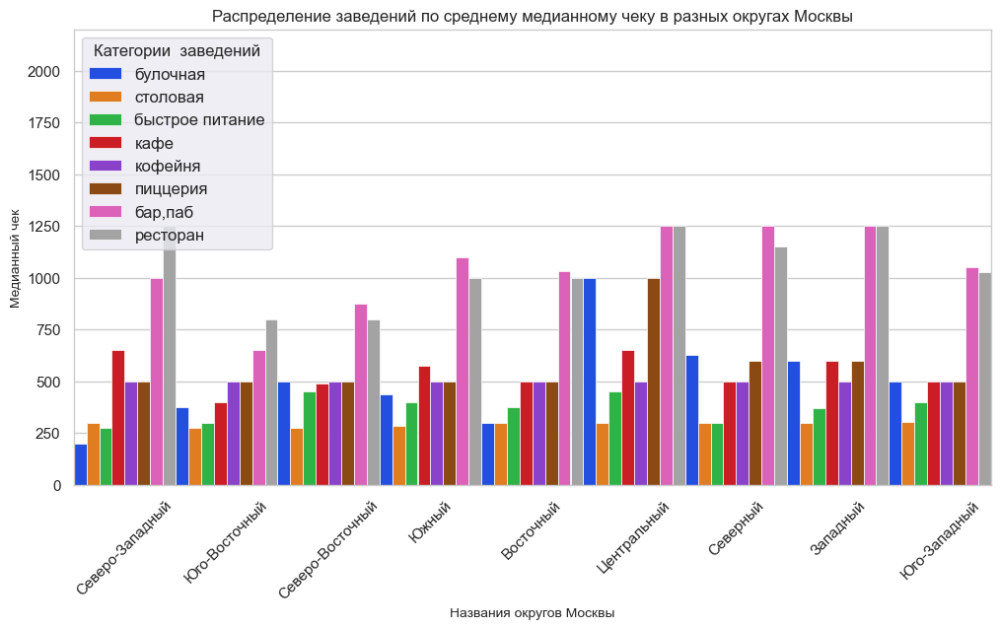

In [81]:
df_c = df.groupby(['district','category'], as_index = False).agg({'middle_avg_bill':'median'}).sort_values(by = 'middle_avg_bill')
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'district', y = 'middle_avg_bill', data = df_c, width = 1, hue = 'category')
sns.set(rc={'figure.figsize':(12,8)})
ax.set (xlabel='Названия округов Москвы', ylim = (0,2200),
        ylabel='Медианный чек',
        title='Распределение заведений по среднему медианному чеку в разных округах Москвы')
plt.legend(loc = 'upper left', title = 'Категории  заведений', fontsize = 12)
plt.xticks(rotation = 45)
plt.show()


<div class="alert alert-info">
  Детальный анализ c чека по категориям заведений показывает близкие тенденции для разных округов Москвы: наибольшая
величина чека характерна для баров и ресторанов (чеки для них примерно равны, за исключением Северо-Западного округа, где чек 
ресторанов на 25 % выше, чем у баров); далее плотно идут кафе, кофейни, пиццерии и булочные, которые имеют чек в среднем в 2 раза ниже, чем
рестораны и бары; затем следуют фастфуды и столовые (их чек примерно в 1,5 раза ниже, чем у кофеен и пиццерий). Аномально ведет
себя медианный чек булочных: например в Северо-Западном округе он минимальный, а в Восточном округе равен ресторанному чеку. 
</div>

In [82]:
mos_lat, mos_lng = 55.75, 37.62
m = Map(location = [mos_lat, mos_lng], zoom_start = 10)
m_cluster = MarkerCluster().add_to(m)
df_m = df.groupby('district', as_index = False).agg({'middle_avg_bill':'median'})
def g(row):
    Marker([row['lat'], row['lng']], tooltip = row['category'], popup = f"{row['name']} {row['middle_avg_bill']}").add_to(m_cluster)
df.apply(g, axis = 1)
path = 'C:\\Users\\79284\\Documents\\'
state_geo = path + 'admin_level_geomap — копия.geojson'
folium.Choropleth(
    geo_data = state_geo,
    data = df_m,
    columns = ['district', 'middle_avg_bill'],
    key_on = 'feature.name',
    fill_color = 'YlOrBr',
    fill_opacity = 0.1,
    legend_name = 'Ценовая карта',
    ).add_to(m)
m

<div class="alert alert-info">
  По данных хороплета видно, что заведения с наиболее высоким медианным чеком сосредоточены внутри Третьего транспортного кольца. 
Далее, вплоть до МКАД, медианный чек примерно одинаков для разных заведений с редкими вкраплениями заведений с низким чеком. 
Вблизи 5 км от МКАД заведения с дорогим чеком практически исчезают и увеличивается количество вкраплений заведений с низким чеком.

</div>

<div class="alert alert-info">
  <b> ВЛИНИЕ РЕЙТИНГА ЗАВЕДЕНИЙ И РЕЖИМА ИХ РАБОТЫ НА ВЕЛИЧИНУ МЕДИАННОГО ЧЕКА </b>
     <a id="number"></a> 
</div>

In [83]:
df_c = df.groupby(['category','is_24/7'], as_index = False).agg({'middle_avg_bill':'median'}).sort_values(by = 'middle_avg_bill')
fig = px.bar(df_c, x = 'category', y = 'middle_avg_bill', height = 500, text_auto='.2s', color = 'is_24/7')
fig.update_layout(xaxis_title = 'Категории заведений', yaxis_title = 'Медианная цена, руб.', 
                  title = 'Зависимость медианного чека от режима работы заведений различных категорий')
fig.update_traces(textfont_size=12, textangle=10, textposition="inside", cliponaxis=False)
fig.update_layout(
    legend=dict(orientation = "h", title = 'Режим работы',
       
        x=0.1, 
        y=1,
        title_font_family="Times New Roman",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="LightGrey",
        bordercolor="LightGrey",
        borderwidth=3
    )
)
fig.show()

<div class="alert alert-info">
  Для большинства категорий заведений круглосуточный режим работы не позволяет увеличить медианный чек. Для ресторанов, кафе, 
пиццерий, фастфудов и булочных круглосуточная работа способствует уменьшению медианного чека. У остальных категорий чек не зависит 
от режима работы.
</div>

In [84]:
df_c = df.groupby(['district','is_24/7'], as_index = False).agg({'name':'count'}).sort_values(by = 'name')
fig = px.bar(df_c, x = 'district', y = 'name', height = 500, text_auto='.2s', color = 'is_24/7')
fig.update_layout(xaxis_title = 'Административные округа Москвы', yaxis_title = 'Число заведений', 
                  title = 'Распределение заведений по районам Москвы в зависимости от их режима работы')
fig.update_traces(textfont_size=12, textangle=10, textposition="inside", cliponaxis=False)
fig.update_layout(
    legend=dict(orientation = "h", title = 'Режим работы',
       
        x=0.1, 
        y=1,
        title_font_family="Times New Roman",
        font=dict(
            family="Courier",
            size=12,
            color="black"
        ),
        bgcolor="LightBlue",
        bordercolor="White",
        borderwidth=3
    )
)
fig.show()

<div class="alert alert-info">
  Для всех екатегорий справедливо абсолютное превосходство числа заведений со сменным графиком, круглосуточных заведений 
ничтожно мало. Число круглосуточных заведений незначительно увеличивается при переходе от переферийных округов к центральному. 
</div>

<div class="alert alert-info">
  <b> ИЗУЧЕНИЕ ВЛИЯНИЯ РЕЙТИНГА ЗАВЕДЕНИЙ НА ВЕЛИЧИНУ СРЕДНЕГО ЧЕКА </b>
    <a id="mean"></a>
</div>

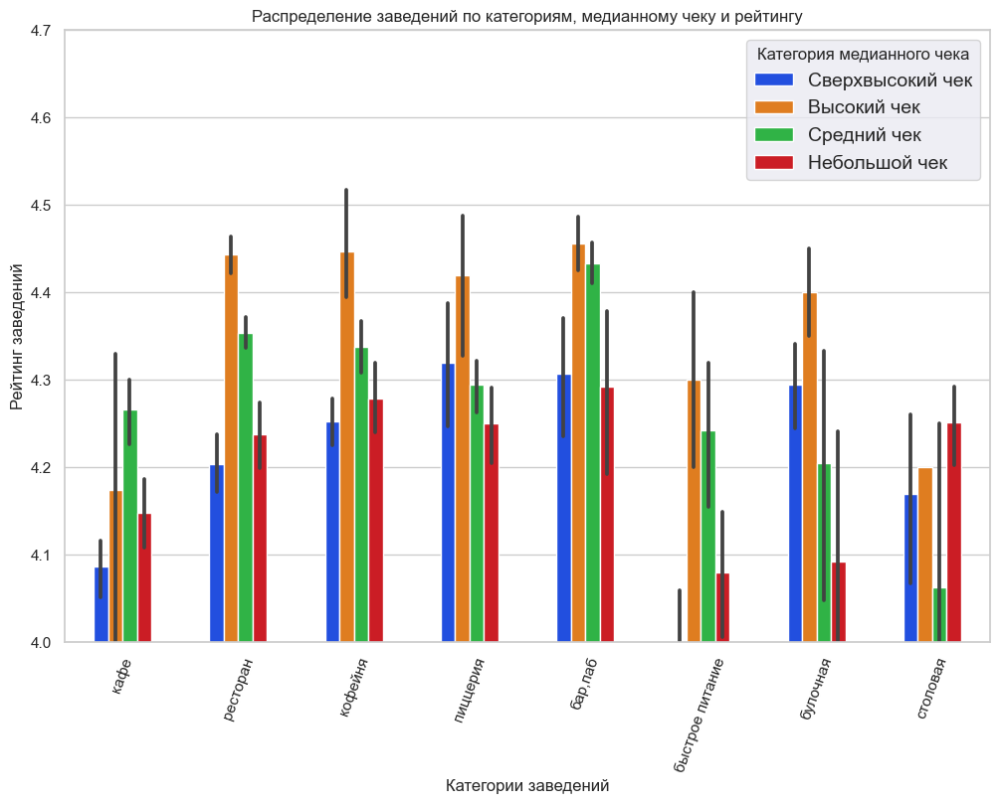

In [85]:
def t(g):
    if g < 500:
        return 'Небольшой чек'
    elif g>=500 and g<1500:
        return 'Средний чек'
    elif g>=1500 and g<5000:
        return 'Высокий чек'
    else:
        return 'Сверхвысокий чек'
df['receipt'] = df['middle_avg_bill'].apply(t)
sns.set_style('whitegrid')
sns.set_palette('bright')
ax = sns.barplot(x = 'category', y = 'rating', hue = 'receipt', data = df, width = 0.5);
sns.set(rc={'figure.figsize':(12,6)})
ax.set (xlabel='Категории заведений', ylim = (4,4.7),
        ylabel='Рейтинг заведений',
        title='Распределение заведений по категориям, медианному чеку и рейтингу')
plt.legend(loc = 'upper right', title = 'Категория медианного чека', fontsize = 14)
plt.xticks(rotation = 70)
plt.show()

<div class="alert alert-info">
  Величина медианного чека была разделена на группы: менее 500 руб - небольшой чек, 500 - 1500 руб - средний чек, 1500 - 5000 - 
высокий чек и более 5000 - сверхвысокий чек. Практически во всех категориях наивысший рейтинг имеют заведения с высоким чеком. 
Исключение составляют наиболее рейтинговые кафе и столовые, имеющие, соответственно, средний чек и небольшой чек. На втором
месте по рейтингу идут заведения со средним чеком, за исключением столовых и кафе (2 место по рейтингу имеют заведения с высоким
чеком). Третье же место по рейтингу в большинстве групп, за исключением ресторанов, фастфудови и кафе нанимают заведения со 
сверхвысоким чеком. Наиминее рейтинговыми, в среднем, являются заведения с небольшим чеком. 
</div>

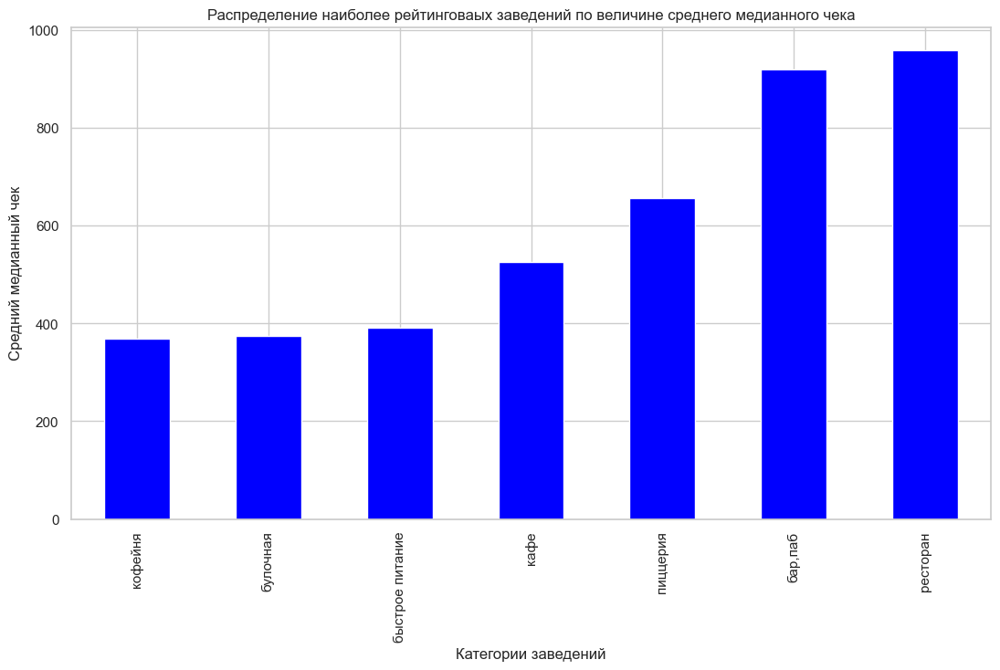

In [86]:
df_t = df.query('rating == 5')
sns.set_style('whitegrid')
sns.set_palette('bright')
df_t.pivot_table(index = 'category', values = 'middle_avg_bill', aggfunc = 'mean').sort_values(by = 'middle_avg_bill').plot(kind='bar',
                                                figsize = (13,7), color = 'blue',
                                                title = 'Распределение наиболее рейтинговаых заведений по величине среднего медианного чека',
                                                xlabel = 'Категории заведений', ylabel = 'Средний медианный чек', legend = False);

<div class="alert alert-info">
  Среди заведений с наивысшим рейтингом (5) рестораны имеют самый высокий средний медианный чек. За ними следуют пиццерии и кафе. 
Рейтинговые кофейни и фастфуды имеют самый низкий средний медианный чек из всех категорий заведений. 
</div>

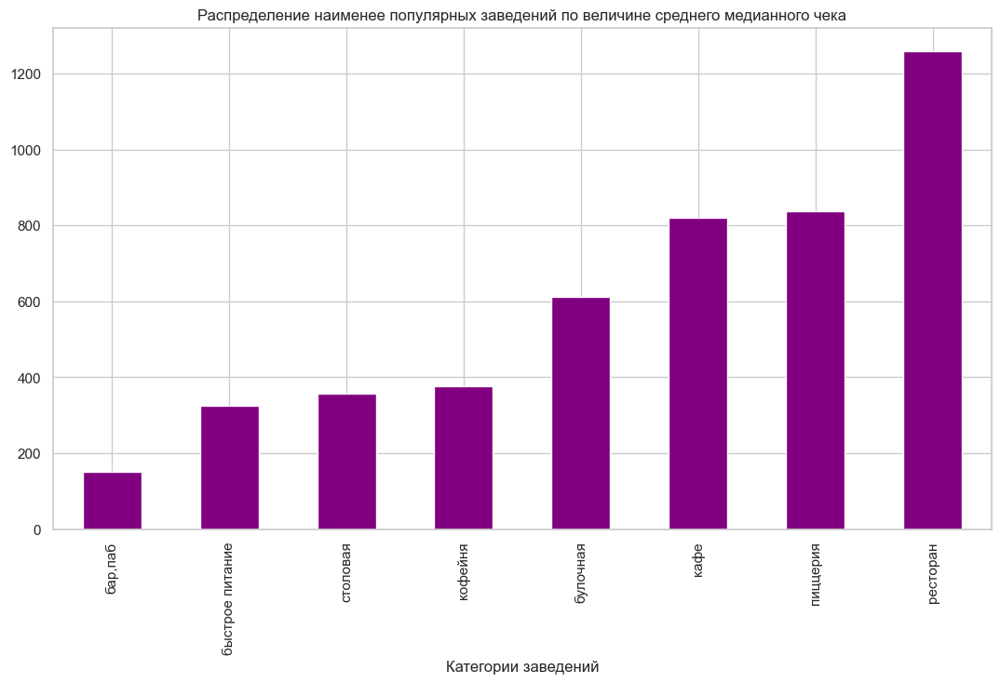

In [87]:
df_t = df.query('rating < 3.5')
sns.set_style('whitegrid')
sns.set_palette('bright')
df_t.pivot_table(index = 'category', values = 'middle_avg_bill', aggfunc = 'mean').sort_values(by = 'middle_avg_bill').plot(kind='bar',
                                                    figsize = (13,7), color = 'purple',
                                                    title = 'Распределение наименее популярных заведений по величине среднего медианного чека',
                                                    xlabel = 'Категории заведений', label = 'Средний медианный чек', legend = False);

<div class="alert alert-info">
  Среди заведений с наименьшим рейтингом (<3.5) рестораны имеют самый высокий средний медианный чек. За ними следуют пиццерии и
кафе. Самые низкорейтинговые бары, фастфуды и столовые имеют самый низкий средний медианный чек из всех категорий заведений. 
</div>

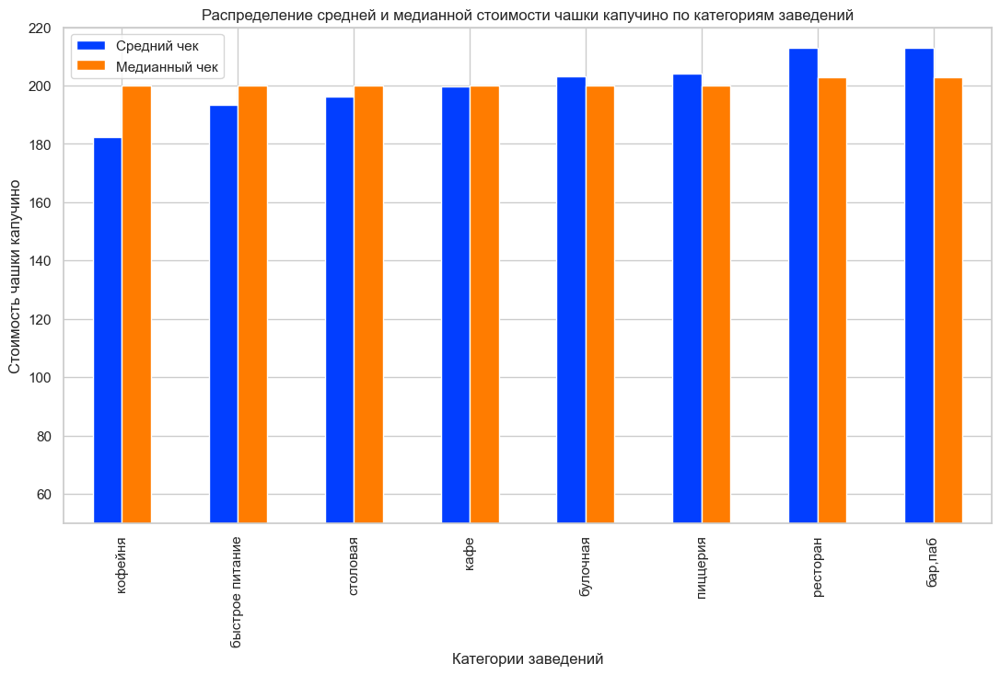

In [88]:

sns.set_style('whitegrid')
sns.set_palette('bright')
df.pivot_table(index = 'category', values = 'middle_coffee_cup', aggfunc = ['mean', 'median']).sort_values(by = ('mean', 'middle_coffee_cup')).plot(kind='bar',
                                                    figsize = (13,7), ylim = (50,220),
                                                    title = 'Распределение средней и медианной стоимости чашки капучино по категориям заведений',
                                                    xlabel = 'Категории заведений', ylabel = 'Стоимость чашки капучино', label = 'Стоимость чашки капучино');
plt.legend(['Средний чек', 'Медианный чек'])


<div class="alert alert-info">
Во всех заведениях величины медианного и среднего чеков для чашки капучино близки (средний чек на 10 - 20 руб. выше), что
говорит об отсутствии большого разброса цен на данную услугу внутри выбранной категории заведенний. 
</div>

<div class="alert alert-info">
  <b> ВЫВОДЫ </b>
    <a id="conc"></a>
    
  <b> Предобработка данных </b>

  Исходная таблица содержит 14 столбцов и 8406 строк. Изучение типов данных в столбцах показывает, что все данные имеют
верный тип, кроме столбца 'seats', который должен иметь тип "integer". Тип данных в столбце 'seats' перевели в "integer". 
Явных дубликатов в данных не было обнаружено. Перевод всех данных столбцов с типом 'object' в строчный режим не выявил неявных 
дубликатов. Cтолбец 'avg_bill' имеет 4590 пропусков, которые заполнить нельзя, так это приведет к искажению информации. Число
пропусковв столбце 'price' с категориальной оценкой чека (5091) меньше, чем в столбцах 'middle_avg_bill'(5257) и 
'middle_coffee_cup'(7871) с численной оценкой чека, что позволяет заменить в них часть пропусков на медианные значения,
характерные для категорий встолбце 'price'. Проведенные замены на медианные значения позволили снизить количество пропусков 
в столбцах 'middle_avg_bill' и 'middle_coffee_cup' до 4621 и 4834, соответственно, что позволило расширить выборку данных для 
дальнейшего анализа. Созданы также дополнительные столбцы: 'street' с названием улиц и 'is_24/7' c булевыми значениями, для
описания режима работы заведений.

   <b> АНАЛИХ ДАННЫХ </b>
    
   <b> Распределение заведений по категориям </b>

  Среди заведений доминируют кафе и рестораны. Кофеен примерно в 2 раза меньше, чем кафе. Меньше всего булочных и 
столовых - в 10 раз меньше, чем ресторанов. Предприятий быстрого питания, пиццерий и баров в 4 раза меньше, чем ресторанов, 
но в 2 раза больше, чем булочных и столовых. Круглосуточных хаведений ничтожно мало - около 5 % от всех ресторанов, фастфудов и
кафе, а для кофеен, пиццерий и баров доля круглосуточных точек менее 5 %.
  Сравнение медианных рейтингов заведений показывавет, что самым высокой оценкой обладают бары и пабы (4,4). Кофейни, ресторны, 
кафе, пиццерии,булочные И столовые имеют близкий рейтинг порядка 4,3. Заведения фастфуда имеют самый низкий медианный рейтинг 
порядка 4,2. Можно также отметить, что переход на 24 часовой режим работы, как правило, понижает (на 0,1 - 0,2) медианный рейтинг для заведений
заведений большинства категорий. Нечувствительны к режиму работы только рестораны и пабы. 
  Для всех рассматриваемых категорий заведений характерно абсолютное преобладание средней ценовой категории. Доля заведений
со средними ценами для большинства категорий на порядок превосходит все остальные ценовые уровни. Исключение составляют только 
бары(пабы) и рестораны, для которых преобладание заведений со средними ценами не является существенным: общее число ресторанов 
и пабов с ценами выше среднего и высокого уровня превышает число ресторанов с ценами среднего уровня. 
  Наибольший медианный чек, как и следовало ожидать, в ресторанах и пабах, причем они практически равны по этому показателю. 
Булочные, кафе, кофейни и пиццерии имеют близкий медианный чек порядка 500 руб., что почти в 3 раза ниже, по сравнению с 
ресторанами и барами. Самый низкие цены в столовых - чек 300 руб. Самая высокая медианная стоимость чашки кофе (200 руб.) 
в барах, затем идут кофейни (170 руб.), кафе и пиццерии (по 150 руб.), и фастфуды (140 руб.).
   Было проанализировано распределение величины среднего чека для заведений средней ценовой категории. По этому показателю 
заведения можно разделить на 2 категории. Заведения первой группы имеют выраженное 8-образное распределение плотности точек (кафе, пиццерии, 
бары и рестораны), что говорит о наибольшем разнообразии состоятельности клиентов, которые предпочитают либо более дорогие, либо дешевые 
заведения. Средний ценовой сегмент для этой группы представлен хуже. Заведения 2 группы (фастфуд, столовые, кофейни, булочные) 
имеют наибольшую плотность точек вблизи среднего чека, что говорит об их ориентации на более узкий диапазон клиентов со
средними достатком и максимальной сбалансированности предложения (блюд и продуктов) для посетителей со средними доходами. 
Вместе с тем, максимальное количество выбросов в сторону относительно дорогого чека, наряду с ресторанами, имеют также кафе,
фастфуды, столовые и кофейни, что говорит о присутствии на рынке нетипичных и довольно дорогих заведений данных категорий.
Булочные и пиццерии практически не имеют выбросов из-за целевой ориентации на сугубо среднеценовую категорию клиентов и
отсутствия в меню каких-то нетипичных дорогих предложений.  

   <b> Распределение посадочных мест между заведениями различных категорий </b>
    
    Большинство заведений (рестораны, кофейни, кафе, фастфуды) имеют сбалансированное распределение средней величины 
посадочных мест по ценовым категориям с небольшим преобладанием высокого ценового сегмента. Для этих заведений число посадочных
мест в дорогих категориях на 20 - 30 % выше, чем в дешевых и средних категориях. В пиццериях и барах баланс посадочных мест
еще более смещен в сторону высоких ценоваых категорий - средние и дешевые заведения имеют в среднем на 70 % мешьше посадочных мест,
чем дорогие заведения. В булочных, наоборот, заведения дешевой и средней ценовых категорий имеют на 70 % больше посадочных мест,
чем более дорогие аналоги. Аномальное число посадочных мест в дорогих столовых является артефактом, которым можно пренебречь,
так как в выборке представлено только одно заведенние такого рода.
    В большинстве заведений не обнаружено значимой корреляции между числом посадочных мест и величиной среднего чека. Это говорит
о том, что размер заведения не связан с его престижем и общим уровнем ценовых предложений. Небольшая положительная корреляция
для пиццерий, кофеен и кафе связана скорее всего с возможностью принимать большие компании, когда сумма чека пропорциональна объему
заказа. При этом, крупные компании и мероприятия не являются основополагающим фактором прибыли заведений. Из этого ряда
выбиваются столовые, для котороых средний чек четко коррелдирует с числом мест. Видимо, это свидетельствует о том, что чем 
крупнее столовая, тем более дорогие блюда у нее в ассортименте тем большее количенство больших компаний ее посещают и больше
проводится мероприятий. Однако, данная аномалия частично объясняется отсутствием столовых дорогих сегментов, что непропорционально
увеличивает среднюю корреляцию.
    В средней ценовой категории булочные имеют неплохую корреляцию (0,45) между величиной среднего чека и средним количеством посадочных
мест. Кофейни, пиццерии, бары и особенно фастфуды демонстрируют практическую независимость чека от числа мест, а рестораны
имеют незначительную отрицательную корреляцию. Таким образом, для в средней ценовой категории для увеличения среднего чека 
целесообразно увеличить число мест только в булочных. В гораздо меньшей степени рост чисмла мест положительно сказывается на чеке
кафе, пиццерий, кофеен и баров.
    В высокой ценовой категории для увеличения среднего чека целесообразно увеличивать число посадочных мест только в булочных. 
Наоборот, увеличение числа мест в фастфудах отчетливо приводит к снижению среднего чека. Кофейни, пиццерии, кафе и бары весьма
слабо, но негативно реагируют на увеличение числа посадочных мест.
    В низкой ценовой категории увеличение посадочных мест в барах, пиццериях, кафе и столовых с высокой вероятностью увеличит
средний чек. Для булочных, наоборот, увеличение числа мест однозначно снижает средний чек.

  <b> Сравнение количества сетевых и несетевых заведений </b>

    Наибольшая доля сетевых заведений приходится на булочные (порядка 70 % сетевых булочных). Кофейни и пиццерии включают порядка 50 % 
сетевых заведений. Доля сетевых ресторанов, кафе и фастфудов порядка 30 - 40 %. Меньше всего доля сетевых столовых и баров - менее 30 %.
Таким образом, чаще всего приходится встречаться с сетеваыми булочными, кофейнями и пиццериями, а наименьшая вероятность встретить
сетевое заведение, посещая столовые и бары.   
   Самая популярная сеть - Шоколадница (120 объектов), замыкает 15 популярнейших сетей Му-Му (менее 30 объектов). В топ-5 вошли 2 
пиццерии (Доминос и Додо), 2 кофейни (Шоколадница и One-Price-Coffee). Всего же в топ-15 входят 6 кофеен, 2 пиццерии, 3 ресторана,
3 кафе и 1 булочная.

  <b> Распределение заведений по районам Москвы </b>

   Количество заведений в Центральном округе Москвы примерно в 2 раза превышает общее число заведений в каждом из прочих округов. 
Все остальные оуруга имеют примерно одинаковое общее число заведений, за исключением Северо-Западного округа, число заведений 
в котором примерно в 1,5 раза ниже. При анализе категорий заведений можно сказать, что во всех округах с серьезным отрывом 
преобладают кафе. В топ-6 категорий почти во всех округах входят (по убыванию численности): кафе, рестораны, кофейни, пиццерии,
фастфуды и бары. Исключение составляет Центральный округ, в котором аномально доминируют рестораны, а бары находятся на 4 месте,
опережая пиццерии и фастфуды. Можно также отметить, что в Северном округе рестораны и кофейни одинаково популярны.  

   <b> Сравнение рейтингов различных категорий заведений </b>

    Наиболее рейтинговыми заведениями являются бары, пиццерии и рестораны. Чуть менее популярны кофейни и булочные. Самым низким 
рейтингом обладают фастфуды и кафе. Плотность наиболее рейтинговых заведений максимальна внутри Садового кольца. При удалении от 
центра нарастает плотность заведений со средними рейтингами с увеличением частоты вкроплений низкорейтинговых точек.

   <b> Распределение заведений по самым насыщенным общепитом улицам </b>
    
    В топ-5 самых насыщенных различными заведениями улиц входят проспект Мира, МКАД, Профсоюзная улица, Ленинский проспект и проспект
Вернадского. Распределение заведений по категориям, в целом, тождественно для разных улиц и напоминает распределение заведений
по округам Москвы: на первом месте кафе, затем идут рестораны и кофейни. Фастфуды, пиццерии и бары занимают следующие строчки,
с переменным преобладанием от улицы к улице. Аутсайдерами являются булочные и столовые. 
   Среди одиночных заведений преобладают кафе, рестораны и кофейни (аналогичо распределению заведений по округам и насыщенным 
улицам Москвы). Далее следуют столовые и бары, наименее распространены пиццерии и булочные. Среди всех категорий заведений с 
большим отрывом преобладают предприятия с хорошим рейтингом (4), затем идут точки с отличным рейтингом (5). Заведений с низким
рейтингом (3 и ниже) во всех категориях незначительное количество до полного отсутствия (бары, пиццерии и булочные). 
  
    <b> Анализ величины медианного чека в разных районах Москвы </b>
    
    Во всех округах Москвы величина медианного чека заведений (без дифференциации на категории) примерно одинакова (около 500 руб). 
Исключения составляют Юго-Западный, Западный и Центральный округа, где медианный чек растет, соответственно, до 550, 700 и 1000 руб.
    Детальный анализ медианного чека по категориям заведений показывает близкие тенденции для разных округов Москвы: наибольшая
величина чека характерна для баров и ресторанов (чеки для них примерно равны, за исключением Северо-Западного округа, где чек 
ресторанов на 25 % выше, чем у баров); далее плотно идут кафе, кофейни, пиццерии и булочные, котороые имеют чек в среднем в 2 раза ниже, чем
рестораны и бары; затем следуют фастфуды и столовые (их чек примерно в 1,5 раза ниже, чем у кофеен и пиццерий). Аномально ведет
себя медианный чек булочных: например в Северо-Западном округе он минимальный, а в Восточном округе равен ресторанному чеку. 
    По данных хороплета видно, что заведения с наиболее высоким медианным чеком сосредоточены внутри Третьего транспортного кольца. 
Далее, вплоть до МКАД, медианный чек примерно одинаков для разных заведений с редкими вкраплениями заведений с низким чеком. 
Вблизи 5 км от МКАД заведения с дорогим чеком практически исчезают и увеличивается количество вкраплений заведений с низким чеком.

   <b> Влияние рейтинга заведений и режима их работы на величину медианного чека </b>
    
    Для большинства категорий заведений круглосуточный режим работы не позволяет увеличить медианный чек. Для ресторанов, кафе, 
пиццерий, фастфудов и булочных круглосуточная работа способствует уменьшению медианного чека. У остальных категорий чек не зависит 
от режима работы.
    Для всех екатегорий справедливо абсолютное превосходство числа заведений со сменным графиком, круглосуточных заведений 
ничтожно мало. Число круглосуточных заведений незначительно увеличиваается при переходе от переферийных округов к центральному.

    <b> Влияние рейтинга заведений на величину среднего чека </b>
    
  Величина медианного чека была разделена на группы: менее 500 руб - небольшой чек, 500 - 1500 руб - средний чек, 1500 - 5000 - 
высокий чек и более 5000 - сверхвысокий чек. Практически во всех категориях наивысший рейтинг имеют заведения с высоким чеком. 
Исключение составляют наиболее рейтинговые кафе и столовые, имеющие, соответственно, средний чек и небольшой чек. На втором
месте по рейтингу идут заведения со средним чеком, за исключением столовых и кафе (2 место по рейтингу имеют заведения с высоким
чеком). Третье же место по рейтингу в большинстве групп, за исключением ресторанов, фастфудови кафе занимают заведения со 
сверхвысоким чеком. Наиминее рейтинговыми, в среднем, являются заведения с небольшим чеком.   
  Среди заведений с наивысшим рейтингом (5) рестораны имеют самый высокий средний медианный чек. За ними следуют пиццерии и кафе. 
Рейтинговые кофейни и фастфуды имеют самый низкий средний медианный чек из всех категорий заведений. 
  Среди заведений с наименьшим рейтингом (<3.5) рестораны имеют самый высокий средний медианный чек. За ними следуют пиццерии и
кафе. Самые низкорейтинговые бары, фастфуды и столовые имеют самый низкий средний медианный чек из всех категорий заведений. 
  Следует отметить наличие четкой корреляции между величиной среднего медианного чека и ценовой категорией заведений различного
типа. Эта связь особенно характерна для фастфудов и столовых.
</div>

<div class="alert alert-info">
  <b> ДЕТАЛИЗАЦИЯ ПЛАНА ПО УЧРЕЖДЕНИЮ КОФЕЙНИ </b>
   <a id="plan"></a>  
    
  1) В Москве около 1500 кофеен, большинство из них (более 400) расположены в Центральном округе, около 200 - в Северном округе.
В Северо-Восточном, Южном и Западном округах размещено примерно по 150 кофеен. В Восточном, Юго-Западном и Юго-Восточном округах - по 100 кофеен. Меньше всего кофеен в Северо-Западном округе - около 50. В целом, по распространенности во всех округах Москвы
кофейни прочно занимают 3 место сразу после ресторанов и кафе. 
  2) Круглосуточные кофейни существуют, но их доля от общей численности подобного рода заведений ничтожна (менее 5 %). Дневные
кофейни имеют чуть более высокий рейтинг (4,3), по сравнению с круглосуточными (4,2). Медианный чек не зависит о режима работы
кофейни.
  3) В целом, кофейни имеют хороший средний рейтинг (около 4,3) и лишь немного уступают по этому показателю только пиццериям (4,3) и барам (4,4). Медианный рейтинг кофеен в разных округах Москвы одинаков и составляет 4,3. По величине среднего рейтинга 
распределение кофеен по округам более информативно: самые рейтинговые кофейни (более 4,3) расположены в Центральном и 
Северо-Западном округах, далее идут Северный, Юго-Западный и Восточный округа (около 4,3). Еще менее популярны кофейни в Южном,
Юго-Восточном и Серверо-Восточном округах (около 4,2). Самые непопулярные кофейни расположены в Западном округе (менее 4,2).
  4) Во всех заведениях величины медианного и среднего чеков для чашки капучино близки (средний чек на 10 - 20 руб. выше), что
говорит об отсутствии большого разброса цен на данную услугу внутри выбранной категории заведенний. Самый дорогоцй кофе в барах
(порядка 200 руб.), а в кофейнях цена капучино составаляет около 170 руб. В пиццериях капучино стоит уже около 150 руб. Поэтому 
стоимость чашки кофе должна лежать в интервале 150 - 170 руб., так как это соответствует средней стоимости данной услуги в 
аналогичных заведениях. 
  5) Кофейни достаточно популярны в Москве: в топ-15 сетевых заведений большинство представлено кофейнями (6 сетей). Кроме того,
кофейни прочно занимают 3 место (после кафе и ресторанов) по распространенности на самых загруженных улицах Москвы, а также на
улицах с наименьшей плотностью заведений.
  6) Кофейни имеют наименьший средний медианный чек (порядка 300 руб.) из всех рейтинговых заведений (рейтинг = 5), что говорит
о существенном потенциале роста прибыльности данной категории. Наиболее популярны кофейни с высоким и средним чеком. Так как,
диаграмма распределения кофеен по среднему чеку не имеет дорогих выбросов, то оптимальны кофейни ценовой категории выше среднего. 
  7) Для кофеен большинства ценовых категорий (низкой, средней и выше среднего) характерно 50 посадочных мест. Кофейни с высокими ценами имеют в среднем 100 посадочных мест. Для кофеен средней ценовой категории характерна слабая корреляция медианной величины среднего чека от числа посадочных мест (коэф корреляции порядка 0,1). Для остальных ценовых категорий кофеен корреляции чека и числа мест не обнаружено. То есть, для кофейни средней ценовой категории и выше среднего оптимально 50 посадочных мест или немного больше. 
</div>
  

<div class="alert alert-info">
  <b> ОПТИМАЛЬНОЕ РАСПОЛОЖЕНИЕ КОФЕЙНИ </b>
    <a id="loc"></a> 
</div>

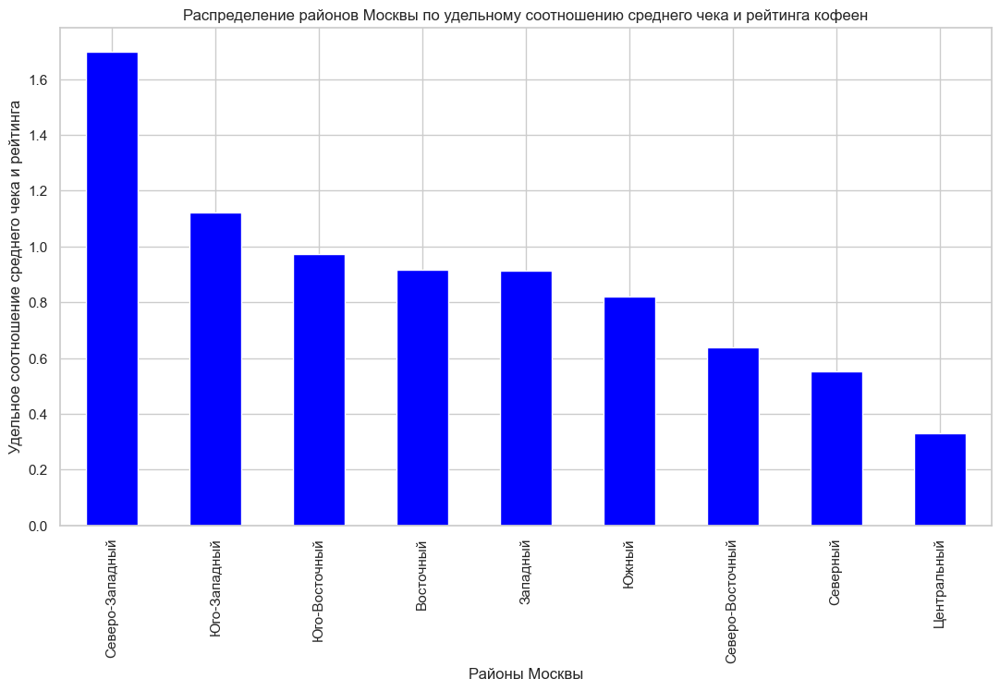

In [89]:
df_f = df.query('category == "кофейня"')
df_s = df_f.pivot_table(index = 'district', values = ['middle_avg_bill','rating'], aggfunc = ['mean', 'count'])
df_s['ratio_opt'] = df_s['mean']['middle_avg_bill']/(df_s['mean']['rating']*df_s['count']['rating'])
df_s.sort_values(by = 'ratio_opt', ascending = False).plot(kind='bar', y = 'ratio_opt',
                                                figsize = (13,7), color = 'blue',
                                                title = 'Распределение районов Москвы по удельному соотношению среднего чека и рейтинга кофеен',
                                                xlabel = 'Районы Москвы', ylabel = 'Удельное соотношение среднего чека и рейтинга', legend = False);


 <div class="alert alert-info">
  При выборе округа Москвы для размещения кофейни очевидно стоит позаботиться о минимальной конкуренции (оценивается числом
имеющихся кофеен), относительной нехваткой рейтинговых заведений (оценивается средним рейтингом) и потенциальной прибыльностью
заведения (оценивается средним чеком кофеен в данном округе).
  Оптимальным районом Москвы для новой кофейни является район, в котором для данной категории заведений можно ожидать максимальный
средний чек при минимальном числе кофеен и их минимальном рейтинге. Для сравнитнельной оценки районов для каждого из них был
вычислен показатель удельного соотношения среднего чека и среднего рейтинга кофеен. Данный показатель равен отношению среднего
чека кофеен данного района к произведению их числа и среднего рейтинга.
   В результате максимальное значение удельного соотношения чека и рейтинга (1,7) имеет Северо-Западный район, для которого 
данная величина существенно выше ближайших конкурентов - Юго-Западного (1,1) и Юго-Восточного (около 1) районов.
   Таким образом, можно ожидать, что, выбрав для размещения кофейни Северо-Западный округ и обеспечив достаточно высокое качество
обслуживания, кофейня имеет все шансы стать наиболее популярной и приносить наибольшую прибыль.  
</div>

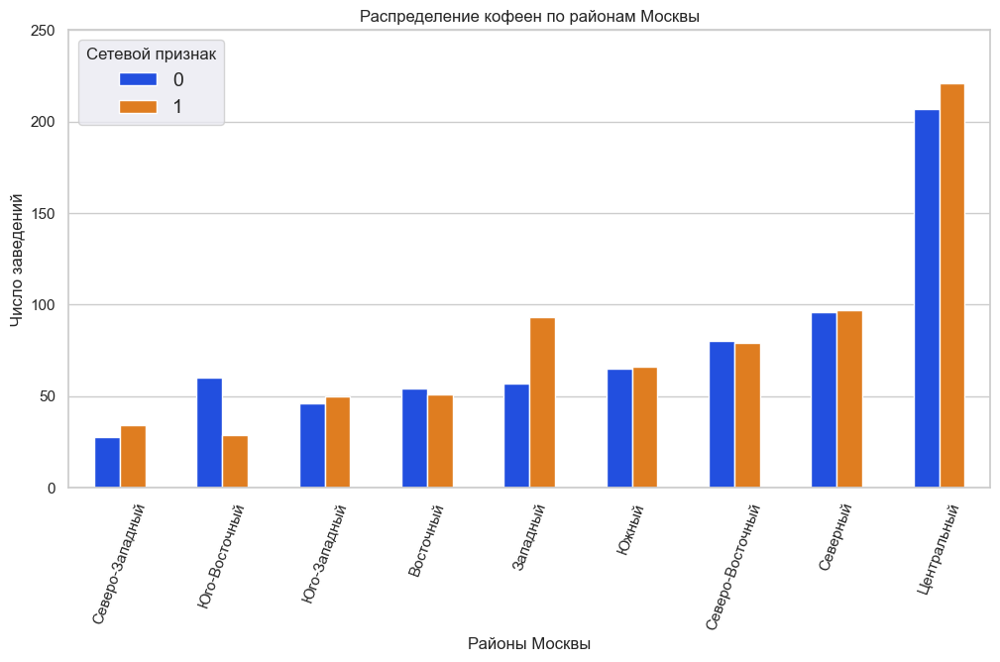

In [90]:
sns.set_style('whitegrid')
sns.set_palette('bright')
df_m = df.query('category == "кофейня"')
df_n = df_m.groupby(['district','chain'], as_index = False).agg({'name':'count'}).sort_values(by = 'name')
ax = sns.barplot(x = 'district', y = 'name', hue = 'chain', data = df_n, width = 0.5);
sns.set(rc={'figure.figsize':(12,6)})
ax.set (xlabel='Районы Москвы', ylim = (0,250),
        ylabel='Число заведений',
        title='Распределение кофеен по районам Москвы')
plt.legend(loc = 'upper left', title = 'Сетевой признак', fontsize = 14)
plt.xticks(rotation = 70)
plt.show()

<div class="alert alert-info">
  Меньше всего кофеен, как и ожидалось, в Северо-Западном округе. Причем, сетевых немного больше, чем независимых кофеен.
</div>

C:\Users\79284\AppData\Local\Temp\ipykernel_21252\2671119025.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



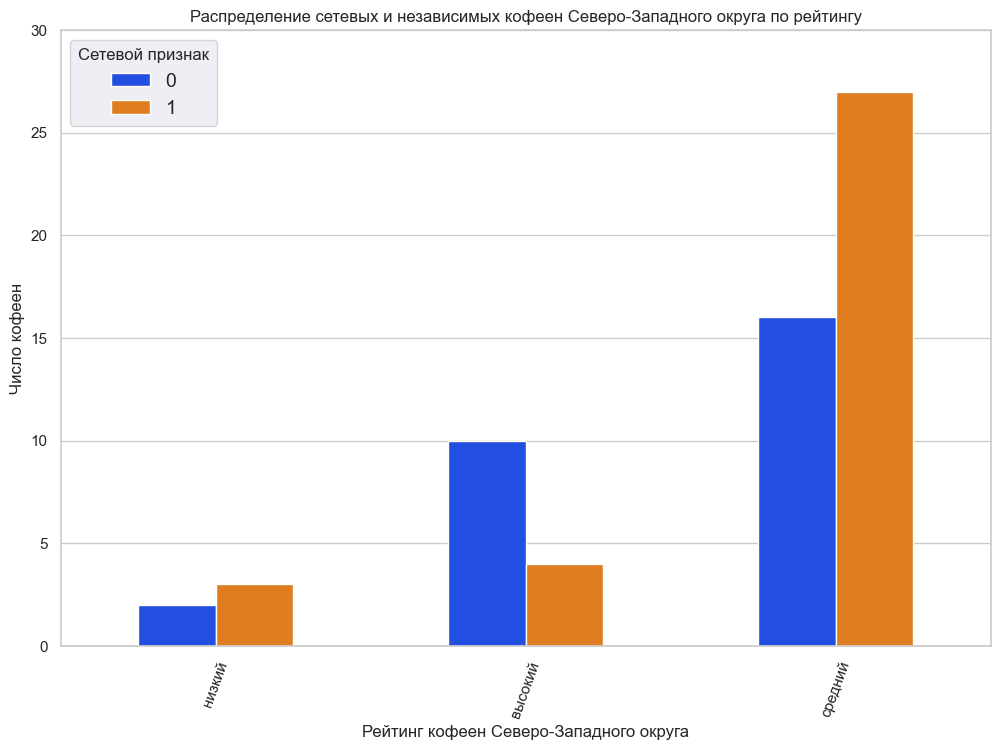

In [96]:
sns.set_style('whitegrid')
sns.set_palette('bright')
df_m = df.query('category == "кофейня" and district == "Северо-Западный"')
def g(t):
    if t > 4.5 and t <=5:
        return 'высокий'
    elif t > 3.9 and t <= 4.5:
        return 'средний'
    elif t <= 3.9:
        return 'низкий'
df_m['rank'] = df_m['rating'].apply(g)
df_n = df_m.groupby(['rank','chain'], as_index = False).agg({'name':'count'}).sort_values(by = 'name')
ax = sns.barplot(x = 'rank', y = 'name', hue = 'chain', data = df_n, width = 0.5);
sns.set(rc={'figure.figsize':(12,6)})
ax.set (xlabel='Рейтинг кофеен Северо-Западного округа', ylim = (0,30),
        ylabel='Число кофеен',
        title='Распределение сетевых и независимых кофеен Северо-Западного округа по рейтингу')
plt.legend(loc = 'upper left', title = 'Сетевой признак', fontsize = 14)
plt.xticks(rotation = 70)
plt.show()

<div class="alert alert-info">
  Среди кофеен Северо-Западного округа со средним рейтингом число сетевых заведений почти в 2 раза превышает число независимых. 
Наоборот, для кофеен с высоким рейтингом число независимых более, чем в 2 раза больше, чем сетевых. Поэтому, при выборе категории
новой кофейни с точки зрения рейтинга лучше ориентироваться на оригинальное заведение, чем выкупать франшизу. 
</div>

<div class="alert alert-info">
Ссылка на презентацию: https://disk.yandex.ru/i/MVExyYSmnVXoRA
 <a id="vis"></a> 
</div>